In [1]:
# sph related imports
from sph import *
from perlin import *
# neural network rlated imports
from torch.optim import Adam
from rbfConv import *
from torch_geometric.loader import DataLoader
from trainingHelper import *
# plotting/UI related imports
from plotting import *
import matplotlib as mpl
# plt.style.use('dark_background')
cmap = mpl.colormaps['viridis']
from tqdm.notebook import trange, tqdm
from IPython.display import display, Latex
from datetime import datetime
from rbfNet import *
from tqdm.notebook import tqdm
import h5py
import matplotlib.colors as colors
%matplotlib notebook

In [2]:
torch.cuda.is_available()

True

In [3]:
trainingFiles = ['./output/' + f for f in os.listdir('./output/') if f.endswith('.hdf5')]
testingFiles = ['./outputTest/' + f for f in os.listdir('./outputTest/') if f.endswith('.hdf5')]
# print(testingFiles)

In [4]:
# Load generic settings
inFile = h5py.File(trainingFiles[0],'r')
minDomain = inFile.attrs['minDomain']
maxDomain = inFile.attrs['maxDomain']

baseArea = inFile.attrs['baseArea']
particleRadius = inFile.attrs['particleRadius']
particleSupport = inFile.attrs['particleSupport']

xsphConstant = inFile.attrs['xsphConstant']
diffusionAlpha = inFile.attrs['diffusionAlpha']
diffusionBeta = inFile.attrs['diffusionBeta']
kappa = inFile.attrs['kappa']
restDensity = inFile.attrs['restDensity']
c0 = inFile.attrs['c0']
dt = inFile.attrs['dt']

numParticles = inFile.attrs['numParticles']
timesteps = inFile.attrs['timesteps']

generator = inFile.attrs['generator']
inFile.close()

# Load generator settings
settings = {}
for f in trainingFiles:
    inFile = h5py.File(f,'r')
    generatorSettings = {}
    for k in inFile['generatorSettings'].attrs.keys():
        generatorSettings[k] = inFile['generatorSettings'].attrs[k]
#     print(generatorSettings)
    setup = {}
    setup['generatorSettings'] = generatorSettings
    setup['minDomain'] = inFile.attrs['minDomain']
    setup['maxDomain'] = inFile.attrs['maxDomain']

    setup['baseArea'] = inFile.attrs['baseArea']
    setup['particleRadius'] = inFile.attrs['particleRadius']
    setup['particleSupport'] = inFile.attrs['particleSupport']

    setup['xsphConstant'] = inFile.attrs['xsphConstant']
    setup['diffusionAlpha'] = inFile.attrs['diffusionAlpha']
    setup['diffusionBeta'] = inFile.attrs['diffusionBeta']
    setup['kappa'] = inFile.attrs['kappa']
    setup['restDensity'] = inFile.attrs['restDensity']
    setup['c0'] = inFile.attrs['c0']
    setup['dt'] = inFile.attrs['dt']

    setup['numParticles'] = inFile.attrs['numParticles']
    setup['timesteps'] = inFile.attrs['timesteps']

    setup['generator'] = inFile.attrs['generator']
    settings[f] = setup
    inFile.close()
    
for f in testingFiles:
    inFile = h5py.File(f,'r')
    generatorSettings = {}
    for k in inFile['generatorSettings'].attrs.keys():
        generatorSettings[k] = inFile['generatorSettings'].attrs[k]
#     print(generatorSettings)
    setup = {}
    setup['generatorSettings'] = generatorSettings
    setup['minDomain'] = inFile.attrs['minDomain']
    setup['maxDomain'] = inFile.attrs['maxDomain']

    setup['baseArea'] = inFile.attrs['baseArea']
    setup['particleRadius'] = inFile.attrs['particleRadius']
    setup['particleSupport'] = inFile.attrs['particleSupport']

    setup['xsphConstant'] = inFile.attrs['xsphConstant']
    setup['diffusionAlpha'] = inFile.attrs['diffusionAlpha']
    setup['diffusionBeta'] = inFile.attrs['diffusionBeta']
    setup['kappa'] = inFile.attrs['kappa']
    setup['restDensity'] = inFile.attrs['restDensity']
    setup['c0'] = inFile.attrs['c0']
    setup['dt'] = inFile.attrs['dt']

    setup['numParticles'] = inFile.attrs['numParticles']
    setup['timesteps'] = inFile.attrs['timesteps']

    setup['generator'] = inFile.attrs['generator']
    settings[f] = setup
    inFile.close()

<IPython.core.display.Javascript object>


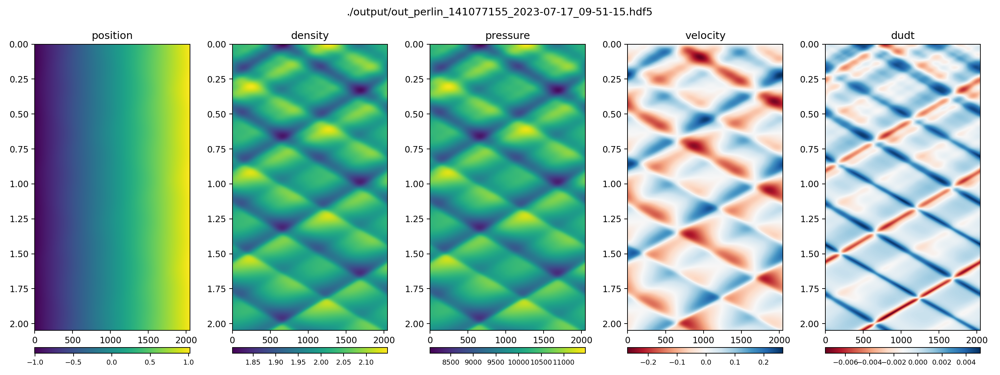

In [5]:
def loadFile(t, plot = False):
    inFile = h5py.File(t,'r')
    fluidPositions = np.array(inFile['simulationData']['fluidPosition'])
    
    fluidVelocities = np.array(inFile['simulationData']['fluidVelocities'])
    fluidDensity = np.array(inFile['simulationData']['fluidDensity'])
    fluidPressure = np.array(inFile['simulationData']['fluidPressure'])
    fluidAreas = np.array(inFile['simulationData']['fluidAreas'])
    dudt = np.array(inFile['simulationData']['dudt'])
    if plot:
        fig, axis = plt.subplots(1, 5, figsize=(16,6), sharex = False, sharey = False, squeeze = False)

        def plot(fig, axis, mat, title, cmap = 'viridis'):
            im = axis.imshow(mat, extent = [0,numParticles,dt * timesteps,0], cmap = cmap)
            axis.axis('auto')
            ax1_divider = make_axes_locatable(axis)
            cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
            cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
            cb1.ax.tick_params(labelsize=8) 
            axis.set_title(title)
        plot(fig,axis[0,0], fluidPositions, 'position')
        plot(fig,axis[0,1], fluidDensity, 'density')
        plot(fig,axis[0,2], fluidPressure, 'pressure')
        plot(fig,axis[0,3], fluidVelocities, 'velocity', 'RdBu')
        plot(fig,axis[0,4], dudt, 'dudt', 'RdBu')

        fig.suptitle(t)
        fig.tight_layout()
    inFile.close()
    return {'positions': torch.tensor(fluidPositions).type(torch.float32), 'density': torch.tensor(fluidDensity).type(torch.float32), 'pressure':torch.tensor(fluidPressure).type(torch.float32), 'area': torch.tensor(fluidAreas).type(torch.float32), 'velocity': torch.tensor(fluidVelocities).type(torch.float32), 'dudt' : torch.tensor(dudt).type(torch.float32)}
data = loadFile(trainingFiles[0], True)

<IPython.core.display.Javascript object>


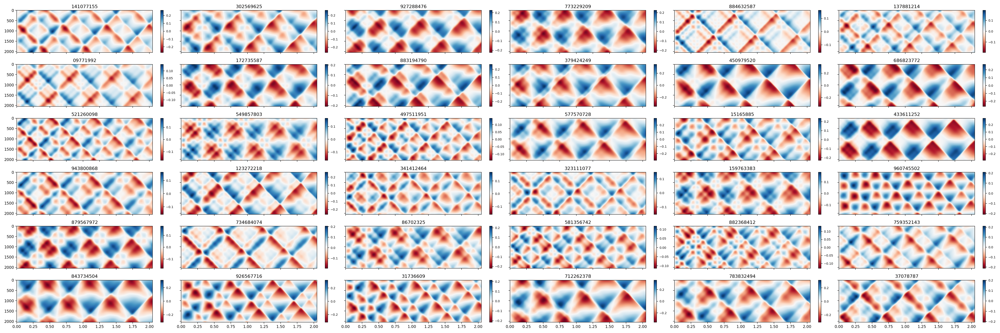

In [6]:
ns = int(np.sqrt(len(trainingFiles)))
fig, axis = plt.subplots(ns, ns, figsize=(ns*6,ns * 2), sharex = True, sharey = True, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,dt * timesteps,numParticles,0], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)

for i in range(ns):
    for j in range(ns):
        data = loadFile(trainingFiles[ns * j + i], False)
        plot(fig,axis[i,j], data['velocity'].mT, trainingFiles[ns * j + i].split('/')[-1].split('.')[0].split('_')[2], 'RdBu')
#         plot(fig,axis[i,j], data['dudt'].mT, trainingFiles[ns * j + i].split('/')[-1].split('.')[0].split('_')[2], 'RdBu')

fig.tight_layout()

<IPython.core.display.Javascript object>


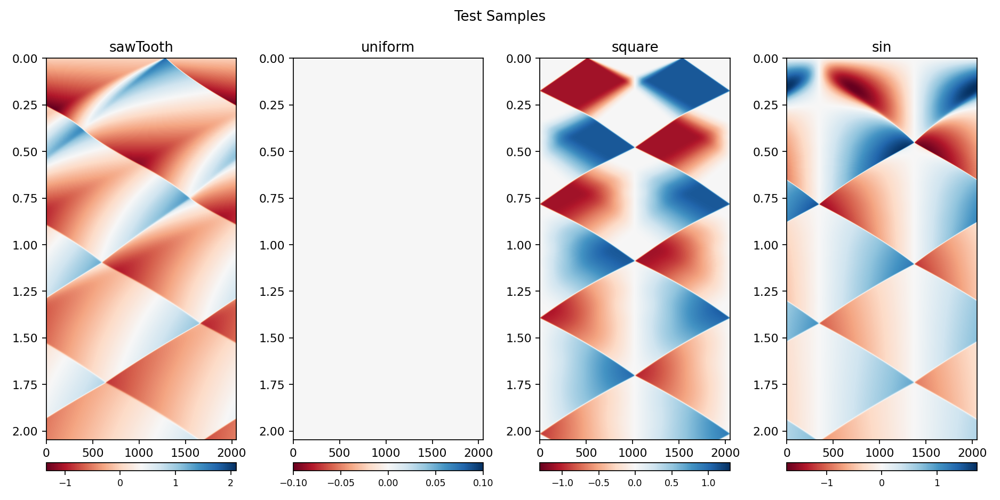

In [9]:

fig, axis = plt.subplots(1, len(testingFiles), figsize=(len(testingFiles)*3,6), sharex = False, sharey = False, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,numParticles,dt * timesteps,0], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
    
for i in range(len(testingFiles)):
    data = loadFile(testingFiles[i], False)
    plot(fig,axis[0,i], data['velocity'], testingFiles[i].split('/')[-1].split('.')[0], 'RdBu')

fig.suptitle('Test Samples')
fig.tight_layout()

In [10]:
testingFiles = trainingFiles[-4:]
trainingFiles = trainingFiles[:-4]
print(len(testingFiles))

4


In [11]:
trainingData = {}
for f in tqdm(trainingFiles):
    trainingData[f] = loadFile(f, False)
testingData = {}
for f in tqdm(testingFiles):
    testingData[f] = loadFile(f, False)

# inFile.close()

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

In [12]:
print(trainingData[trainingFiles[0]]['positions'][:1024,:])
import matplotlib.colors as colors

tensor([[-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990],
        [-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990],
        [-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990],
        ...,
        [-1.0015, -1.0005, -0.9995,  ...,  0.9955,  0.9965,  0.9975],
        [-1.0015, -1.0005, -0.9995,  ...,  0.9955,  0.9965,  0.9975],
        [-1.0014, -1.0004, -0.9994,  ...,  0.9956,  0.9966,  0.9976]])


<IPython.core.display.Javascript object>


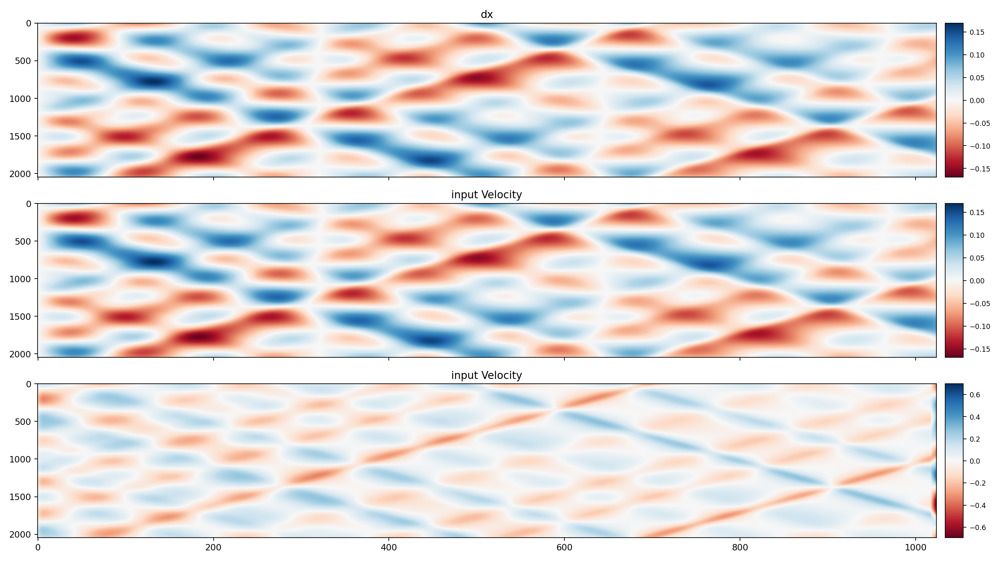

In [13]:
def getStackedUpdates(positions, velocities, accelerations, offset):
    dx = (velocities + accelerations)
    x = dx.mT
    cumsum = torch.cumsum(x, axis = 1)
    s = torch.sum(x, axis = 1, keepdims=True)
    r2lcumsum = x + s - cumsum
    stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))
    return stacked

    
    
    
offset = 8

positions = trainingData[trainingFiles[0]]['positions'][:1024,:]
velocities = trainingData[trainingFiles[0]]['velocity'][:1024,:]
accelerations = trainingData[trainingFiles[0]]['dudt'][:1024,:]
dx = velocities + accelerations

x = dx.mT
cumsum = torch.cumsum(x, axis = 1)
s = torch.sum(x, axis = 1, keepdims=True)
r2lcumsum = x + s - cumsum
stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))

stacked = getStackedUpdates(positions, velocities, accelerations, offset)

fig, axis = plt.subplots(3, 1, figsize=(16,9), sharex = True, sharey = False, squeeze = False)
def imPlot(fig, axis, mat, title):
    im = axis.imshow(mat, cmap = 'RdBu', norm = colors.Normalize(vmin = -np.max(np.abs(mat)), vmax = np.max(np.abs(mat))))
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="1%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
imPlot(fig,axis[0,0], dx.mT.detach().cpu().numpy(), 'dx')
# imPlot(fig,axis[1,0], cumsum.detach().cpu().numpy(), 'cumsum')
# imPlot(fig,axis[2,0], (cumsum[:,1:] - cumsum[:,:-1]).detach().cpu().numpy(), 'cumsum diff')
# imPlot(fig,axis[1,0], r2lcumsum.detach().cpu().numpy(), 'r2l cumsum')
# imPlot(fig,axis[2,0], stacked.detach().cpu().numpy(), 'stacked')


avgVelocity = torch.ones_like(stacked) * 0
avgVelocity[:,offset:] = stacked[:,:-offset]
for i in range(1,offset):
    s = torch.vstack([dx[t,:] for t in range(i)])
    summed = torch.sum(s, dim = 0)
    avgVelocity[:,i] = summed
    
# avgVelocity[:,:offset] = 0
# avgVelocity[:,-offset:] = 0
# stacked[:,:offset] = 0
# stacked[:,-offset:] = 0

# imPlot(fig,axis[1,0], avgVelocity.detach().cpu().numpy(), 'input Velocity')
imPlot(fig,axis[1,0], velocities.mT.detach().cpu().numpy(), 'input Velocity')

imPlot(fig,axis[2,0], (stacked - avgVelocity).detach().cpu().numpy(), 'input Velocity')


# axis[2,0].imshow(stacked.detach().cpu().numpy(), cmap = 'RdBu')
# axis[2,0].axis('auto')
# axis[2,0].set_title('stacked')

fig.tight_layout()

In [14]:
offset = 16
def getStackedUpdates(positions, velocities, accelerations, offset):
    dx = (velocities + accelerations)
    x = dx.mT
    cumsum = torch.cumsum(x, axis = 1)
    s = torch.sum(x, axis = 1, keepdims=True)
    r2lcumsum = x + s - cumsum
    stacked = torch.hstack((r2lcumsum[:,:-offset] - r2lcumsum[:,offset:], r2lcumsum[:,-offset:]))
    return stacked.mT


for f in tqdm(trainingFiles):
    trainingData[f]['stacked'] = getStackedUpdates(trainingData[f]['positions'], trainingData[f]['velocity'], trainingData[f]['dudt'], offset - 1)
for f in tqdm(testingFiles):
    testingData[f]['stacked'] = getStackedUpdates(testingData[f]['positions'], testingData[f]['velocity'], testingData[f]['dudt'], offset - 1)
#     trainingData[f]['averagedVelocity'] = torch.zeros

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

# Task: Learn density (1 timestep)

In [15]:
normalized = False # rbf normalization
batchSize = 4
maxUnrollsteps = 1
# offset = 0

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# device = 'cpu'
dataSet = []
for f in trainingFiles:
    nSteps = settings[f]['timesteps'] - maxUnrollsteps * (offset - 1)
    for j in range(offset - 1, nSteps):
        dataSet.append((f, j))
print('Dataset contains %d samples [%d files @ %d timesteps]' % (len(dataSet), len(trainingFiles), len(dataSet) / len(trainingFiles)))

Dataset contains 64576 samples [32 files @ 2018 timesteps]


In [16]:
# dataSet = [(trainingFiles[0], offset)] * batchSize
# print(dataSet)

In [17]:
# Reading frame t:
t = 0
x = trainingData[f]['positions'][t]
vel = x - trainingData[f]['positions'][max(0, t - (offset - 1))]
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)


vel tensor([0., 0., 0.,  ..., 0., 0., 0.])
dudt tensor([-0.0018, -0.0018, -0.0018,  ..., -0.0018, -0.0018, -0.0018])

x tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
gt tensor([-0.2183, -0.2194, -0.2203,  ..., -0.2163, -0.2169, -0.2177])
vel tensor([0., 0., 0.,  ..., 0., 0., 0.])


In [18]:
settings[trainingFiles[0]]['dt']

0.001

In [19]:
# Reading frame t:
t = offset - 1
x = trainingData[f]['positions'][t]
print(max(0, t - (offset)))
print(x)
print(trainingData[f]['positions'][max(0, t - (offset - 1))])
vel = (x - trainingData[f]['positions'][max(0, t - (offset -1 ))]) / dt
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)

0
tensor([-1.0002, -0.9992, -0.9982,  ...,  0.9968,  0.9978,  0.9988])
tensor([-1.0000, -0.9990, -0.9980,  ...,  0.9970,  0.9980,  0.9990])
vel tensor([-0.0278, -0.0278, -0.0280,  ..., -0.0274, -0.0275, -0.0277])
dudt tensor([-0.0019, -0.0019, -0.0019,  ..., -0.0019, -0.0019, -0.0019])

x tensor([-1.0002, -0.9992, -0.9982,  ...,  0.9968,  0.9978,  0.9988])
gt tensor([-0.6322, -0.6342, -0.6369,  ..., -0.6246, -0.6272, -0.6298])
vel tensor([-0.2184, -0.2195, -0.2204,  ..., -0.2163, -0.2168, -0.2178])


In [20]:
# Reading frame t:
t = offset  + offset - 2
x = trainingData[f]['positions'][t]
print(max(0, t - (offset)))
print(x)
print(trainingData[f]['positions'][max(0, t - (offset - 1))])
vel = (x - trainingData[f]['positions'][max(0, t - (offset -1 ))]) / dt
gt = trainingData[f]['stacked'][t]
print('vel', trainingData[f]['velocity'][t])
print('dudt', trainingData[f]['dudt'][t])
print('')
print('x', x)
print('gt', gt)
print('vel', vel)

14
tensor([-1.0009, -0.9999, -0.9989,  ...,  0.9962,  0.9972,  0.9982])
tensor([-1.0002, -0.9992, -0.9982,  ...,  0.9968,  0.9978,  0.9988])
vel tensor([-0.0532, -0.0534, -0.0537,  ..., -0.0525, -0.0528, -0.0531])
dudt tensor([-0.0012, -0.0013, -0.0012,  ..., -0.0012, -0.0012, -0.0012])

x tensor([-1.0009, -0.9999, -0.9989,  ...,  0.9962,  0.9972,  0.9982])
gt tensor([-0.8799, -0.8840, -0.8872,  ..., -0.8674, -0.8716, -0.8754])
vel tensor([-0.6323, -0.6342, -0.6368,  ..., -0.6245, -0.6273, -0.6298])


In [21]:
torch.manual_seed('1337')

dataLoader = DataLoader(dataSet, shuffle=True, batch_size = batchSize).batch_sampler
dataIter = iter(dataLoader)

In [22]:
from util import *

In [23]:
def getGroundTruth(positions, velocities, areas, densities, dudts, inVel, outVel, i, j, distance, direction):
#     print(dudts, dt)
#     gt = [v + d for v,d in zip(velocities, dudts)] # Learning Density
#     gt = dudts
    term = scatter_sum(torch.hstack(areas)[j] * kernel(torch.abs(distance), particleSupport), i, dim = 0, dim_size = torch.hstack(areas).shape[0])
    return term

    gt = outVel
#     gt = densities
    groundTruth = torch.hstack(gt)
    return groundTruth
def getFeatures(positions, velocities, areas, densities, dudts, inVel, outVel):
    features = torch.ones_like(areas)[:,None]
#     features = torch.vstack((inVel, densities,torch.ones_like(areas))).mT
    return features
#     features = torch.ones_like(areas)
#     return features[:,None]
def lossFunction(prediction, groundTruth):
    return (prediction - groundTruth)**2 # MSE

In [24]:
# Hyperparameters for the NN
lr = 1e-2 # Learning rate
iterations = 1000 # update iterations per epoch
epochs = 5 # total number of epochs, LR is halved every epoch
n = 17 # number of weights per continuous convolution
basis = 'fourier' # basis for the convolution, set to linear for CConv

window = 'cubicSpline'
windowNorm = 'integral'
window = None

In [25]:
layers = [1]
initialLR = 1e-2
particleData = trainingData
groundTruthFn = getGroundTruth
featureFn = getFeatures
lossFn = lossFunction

In [26]:
print(particleSupport)
print(dt)

0.0078125
0.001


In [27]:
def loadTestcase(testingData, settings, f, frames, device, groundTruthFn, featureFn, offset):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = getTestcase(testingData, settings, f, frames, device, offset)

    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
#     print(groundTruth)
    return positions, velocities, areas, density, dudts, features, i, j, distance, groundTruth


In [28]:
testData = {}
for i in range(len(testingFiles)):
#     testData[testingFiles[i].split('/')[-1].split('.')[0]] = loadTestcase(testingData, settings, testingFiles[i], [0, 128, 256, 1024], device, getGroundTruth, getFeatures, offset)
    testData['_'.join(testingFiles[i].split('/')[-1].split('.')[0].split('_')[1:3])] = loadTestcase(testingData, settings, testingFiles[i], [offset, 128, 256, 1024], device, getGroundTruth, getFeatures, offset)
# testData = {}
# for i in range(len(testingFiles)):
#     testData[testingFiles[i].split('/')[-1].split('.')[0]] = loadTestcase(testingData, settings, testingFiles[i], [0], device, getGroundTruth, getFeatures)

In [29]:
# print('_'.join(list(testData.keys())[0].split('_')[1:3]))
# testData.keys()

In [30]:
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

In [38]:
def plotBatch(trainingData, settings, dataSet, bdata, device, offset, model = None):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

#     optimizer.zero_grad()
#     prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
#     lossTerm = lossFn(prediction, groundTruth)
#     loss = torch.mean(lossTerm)
    
    fig, axis = plt.subplot_mosaic('''AF
    BC
    DE''', figsize=(12,8), sharey = False, sharex = False)
    
    positions = torch.vstack(positions).mT.detach().cpu().numpy()
    vel = u.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    area = v.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    dudt = dudt.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    density = rho.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    inVel = inVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    outVel = outVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    gt = groundTruth.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    ft = features[:,0].reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    
    axis['A'].set_title('Position')
    axis['A'].plot(positions)
    axis['B'].set_title('Density')
    axis['B'].plot(positions, density)
    axis['C'].set_title('Difference')
    axis['C'].plot(positions, gt - ft)
    axis['D'].set_title('Instantenous Velocity')
    axis['D'].plot(positions, vel)
    axis['E'].set_title('Ground Truth')
    axis['E'].plot(positions, gt)
    axis['F'].set_title('Features[:,0]')
    axis['F'].plot(positions, ft)
    
    fig.tight_layout()
    
def plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, modelState, groundTruthFn, featureFn, lossFn):
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
    
    with torch.no_grad():
        prediction = modelState['model'](features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
        lossTerm = lossFn(prediction, groundTruth)
        loss = torch.mean(lossTerm)
    
    fig, axis = plt.subplot_mosaic('''ABC
    DEF''', figsize=(16,5), sharey = False, sharex = True)
    
    positions = torch.vstack(positions).mT.detach().cpu().numpy()
    vel = u.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    area = v.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    dudt = dudt.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    density = rho.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    inVel = inVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    outVel = outVel.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    gt = groundTruth.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    ft = features[:,0].reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    loss = lossTerm.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    pred = prediction.reshape(positions.transpose().shape).mT.detach().cpu().numpy()
    
    axis['A'].set_title('Density')
    axis['A'].plot(positions, density)
    axis['E'].set_title('Ground Truth - Features[:,0]')
    axis['E'].plot(positions, gt - ft)
    axis['B'].set_title('Ground Truth')
    axis['B'].plot(positions, gt)
    axis['D'].set_title('Features[:,0]')
    axis['D'].plot(positions, ft)
    axis['C'].set_title('Prediction')
    axis['C'].plot(positions, pred)
    axis['F'].set_title('Loss')
    axis['F'].plot(positions, loss)
    
    fig.tight_layout()
    
# plotBatch(trainingData, settings, dataSet, bdata, device, offset)

In [32]:
def trainModel(particleData, testData, settings, dataSet, trainingFiles, offset, seed, fluidFeatures = 1, n = 16, basis = 'linear', layers = [1], window = None, windowNorm = None, epochs = 5, iterations = 1000, testInterval = 10, initialLR = 1e-2, groundTruthFn = None, featureFn = None, lossFn = None, device = 'cpu'):   
#     random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    np.random.seed(seed)
    
    windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None
    model = RbfNet(fluidFeatures = fluidFeatures, 
                   layers = layers, 
                   denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
                   n = n, windowFn = windowFn, rbf = basis, batchSize = 32, ignoreCenter = True, normalized = False).to(device)   
    lr = initialLR
    optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)
    losses = []
    lossValues = []
    testLosses = {}
    testPredictions = {}
    for e in (pb := tqdm(range(epochs), leave = False)):
        for b in (pbl := tqdm(range(iterations), leave=False)):
            
            try:
                bdata = next(dataIter)
                if len(bdata) < batchSize :
                    raise Exception('batch too short')
            except:
                dataIter = iter(dataLoader)
                bdata = next(dataIter)

            positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
            i, j, distance, direction = batchedNeighborsearch(positions, setup)
            x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

            x = x[:,None].to(device)    
            groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
            distance = (distance * direction)[:,None].to(device)
            features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

            optimizer.zero_grad()
            prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
            lossTerm = lossFn(prediction, groundTruth)
            loss = torch.mean(lossTerm)

            loss.backward()
            optimizer.step()
            losses.append(lossTerm.detach().cpu())
            lossValues.append(loss.detach().cpu().item())

            lossString = np.array2string(torch.mean(lossTerm.reshape(batchSize, positions[0].shape[0]),dim=1).detach().cpu().numpy(), formatter={'float_kind':lambda x: "%.4e" % x})
            batchString = str(np.array2string(np.array(bdata), formatter={'float_kind':lambda x: "%.2f" % x, 'int':lambda x:'%6d' % x}))

            pbl.set_description('%s:  %s -> %.4e' %(batchString, lossString, loss.detach().cpu().numpy()))
            pb.set_description('epoch %2dd, lr %6.4g: loss %.4e [rolling %.4e]' % (e, lr, np.mean(lossValues), np.mean(lossValues[-100:] if len(lossValues) > 100 else lossValues)))
            
            it = e * iterations + b
            if it % testInterval == 0:
                with torch.no_grad():
                    testLossDict = {}
                    testPreds = {}
                    for i, k in  enumerate(testData.keys()):
                        gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        prediction = model(testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0])
                        arr = []
                        for i, (xs, pred, gt) in enumerate(zip(testData[k][0], prediction, gt)):
                             arr.append(lossFn(pred, gt).detach().cpu().numpy())
                        testLossDict[k] = arr
                        testPreds[k] = prediction.detach().cpu()
#                         print(testLossDict[k])
                    testLosses[it] = testLossDict
                    testPredictions[it] = testPreds
#             break
#         break
        
        lr = lr * 0.5
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
            
    return {'model': model, 'optimizer': optimizer, 'finalLR': lr, 'losses': losses, 'testLosses': testLosses, 'testPredictions': testPredictions, 'seed': seed,
            'window': window, 'windowNorm': windowNorm, 'n':n, 'basis':basis, 'layers':layers, 'epochs': epochs, 'iterations': iterations, 'fluidFeatures': fluidFeatures          
           }

In [33]:
import sklearn
import pandas
def signaltonoise_dB(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return 20*np.log10(abs(np.where(sd == 0, 0, m/sd)))

def getTestingLossFrame(modelState, testData, plot = False):
    label = '%s x %2d @ %s' % (modelState['basis'], modelState['n'], str(modelState['layers']))
    testPredictions = {}
    testGTs = {}
    testPositions = {}
    with torch.no_grad():
        for i, k in  enumerate(testData.keys()):
            gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
            prediction = modelState['model'](testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
            testPredictions[k] = prediction
            testGTs[k] = gt.detach().cpu().numpy()
            testPositions[k] = testData[k][0]
    if plot:
        fig, axis = plt.subplots(len(testPredictions.keys()),3, figsize=(16,8), sharex = True, sharey = 'col', squeeze = False)

        for s, k in  enumerate(testData.keys()):
            norm = mpl.colors.Normalize(vmin=0, vmax=len(testPredictions[k]) - 1)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,0].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, rhos) in enumerate(zip(testPositions[k], testPredictions[k])):
                c = cmap(norm(i))
                axis[s,1].plot(xs.cpu().numpy(), rhos, ls = '-', c = c)
            for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
                c = cmap(norm(i))
                axis[s,2].plot(xs.cpu().numpy(), pred- gt, ls = '-', c = c)
        axis[0,0].set_title('GT')
        axis[0,1].set_title('Pred')
        axis[0,2].set_title('Loss')
        fig.tight_layout()
        # axis[0,0].plot()
    lossDict = []
    for s, k in  enumerate(testData.keys()):
        lossTerms = []
        for i, (xs, pred, gt) in enumerate(zip(testPositions[k], testPredictions[k], testGTs[k])):
            loss = (pred - gt)**2
            r2 = sklearn.metrics.r2_score(gt, pred)
            l2 = sklearn.metrics.mean_squared_error(gt, pred)

            maxSignal = np.max(np.abs(gt))
    #         mse = np.mean((pred - gt)**2)
            psnr = 20 * math.log10(maxSignal / np.sqrt(l2))
    #         print(20 * math.log10(maxSignal / np.sqrt(mse)))
    #         print(maxSignal, mse)
    #         male = np.mean(np.abs(np.log(np.abs(pred) / np.abs(gt))[gt != 0]))
    #         rmsle = np.sqrt(np.mean(np.log(np.abs(pred) / np.abs(gt))[gt != 0]**2)
            minVal = np.min(loss)
            maxVal = np.max(loss)
            std = np.std(loss)
            q1, q3 = np.percentile(loss, [25, 75])
    #         print('r2', r2, 'l2', l2, 'psnr', l2, 'min', minVal, 'max', maxVal, 'q1', q1, 'q3', q3, 'std', std)
            lossTerms.append({'label': label, 'seed':modelState['seed'], 'window':modelState['window'], 'file':k, 'basis':modelState['basis'], 'n':modelState['n'],'entry':str(i), 'params': count_parameters(modelState['model']), 'depth':len(modelState['layers']), 'width':np.max(modelState['layers']),'r2':r2,'l2':l2,'psnr':psnr, 'min':minVal, 'max':maxVal, 'q1':q1, 'q3':q3, 'std':std})
    #         print(r2, l2, psnr)
    #         print(male, rmsle)
    #         break
        lossDict += lossTerms
    #     break
    return pandas.DataFrame(data = lossDict)

In [34]:

class RbfNet(torch.nn.Module):
    def __init__(self, fluidFeatures, layers = [32,64,64,2], denseLayer = True, activation = 'relu',
                coordinateMapping = 'cartesian', n = 8, windowFn = None, rbf = 'linear',batchSize = 32, ignoreCenter = True, normalized = False):
        super().__init__()
        self.centerIgnore = ignoreCenter
        self.features = copy.copy(layers)
        self.convs = torch.nn.ModuleList()
        self.fcs = torch.nn.ModuleList()
        self.relu = getattr(nn.functional, 'relu')
        self.layers = layers
        self.normalized = normalized
        if len(layers) == 1:
            self.convs.append(RbfConv(
                in_channels = fluidFeatures, out_channels = self.features[0],
                dim = 1, size = [n],
                rbf = rbf,
                bias = False,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))

            self.centerIgnore = False
            return

        self.convs.append(RbfConv(
            in_channels = fluidFeatures, out_channels = self.features[0],
            dim = 1, size = [n],
            rbf = rbf,
            bias = True,
            linearLayer = False, biasOffset = False, feedThrough = False,
            preActivation = None, postActivation = None,
            coordinateMapping = coordinateMapping,
            batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
                
        self.fcs.append(nn.Linear(in_features=fluidFeatures,out_features= layers[0],bias=True))
        torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
        torch.nn.init.zeros_(self.fcs[-1].bias)

        self.features[0] = self.features[0]
        for i, l in enumerate(layers[1:-1]):
            self.convs.append(RbfConv(
                in_channels = (2 * self.features[0]) if i == 0 else self.features[i], out_channels = layers[i+1],
                dim = 1, size = [n],
                rbf = rbf,
                bias = True,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
            self.fcs.append(nn.Linear(in_features=2 * layers[0] if i == 0 else layers[i],out_features=layers[i+1],bias=True))
            torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
            torch.nn.init.zeros_(self.fcs[-1].bias)
            
        self.convs.append(RbfConv(
            in_channels = self.features[-2] if  len(layers) > 2 else self.features[-2] * 2, out_channels = self.features[-1],
                dim = 1, size = [n],
                rbf = rbf,
                bias = True,
                linearLayer = False, biasOffset = False, feedThrough = False,
                preActivation = None, postActivation = None,
                coordinateMapping = coordinateMapping,
                batch_size = [batchSize, batchSize], windowFn = windowFn, normalizeWeights = False, normalizeInterpolation = normalized))
        self.fcs.append(nn.Linear(in_features=self.features[-2] if  len(layers) > 2 else self.features[-2] * 2,out_features=self.features[-1],bias=True))
        torch.nn.init.xavier_uniform_(self.fcs[-1].weight)
        torch.nn.init.zeros_(self.fcs[-1].bias)


    def forward(self, \
                fluidFeatures, \
                fi, fj, distances):
        if self.centerIgnore:
            nequals = fi != fj

        i, ni = torch.unique(fi, return_counts = True)
        self.ni = ni
        self.li = torch.exp(-1 / 16 * ni)

        if self.centerIgnore:
            fluidEdgeIndex = torch.stack([fi[nequals], fj[nequals]], dim = 0)
        else:
            fluidEdgeIndex = torch.stack([fi, fj], dim = 0)
            
        if self.centerIgnore:
            fluidEdgeLengths = distances[nequals]
        else:
            fluidEdgeLengths = distances
        fluidEdgeLengths = fluidEdgeLengths.clamp(-1,1)
            
        fluidConvolution = (self.convs[0]((fluidFeatures, fluidFeatures), fluidEdgeIndex, fluidEdgeLengths))
        if len(self.layers) == 1:
            return fluidConvolution 
        linearOutput = (self.fcs[0](fluidFeatures))
        ans = torch.hstack((linearOutput, fluidConvolution))
        if verbose:
            print('first layer output', ans[:4])
        
        layers = len(self.convs)
        for i in range(1,layers):
            
            ansc = self.relu(ans)
            
            ansConv = self.convs[i]((ansc, ansc), fluidEdgeIndex, fluidEdgeLengths)
            ansDense = self.fcs[i - 0](ansc)
            
            
            if self.features[i-1] == self.features[i-0] and ans.shape == ansConv.shape:
                ans = ansConv + ansDense + ans
            else:
                ans = ansConv + ansDense
            if verbose:
                print('\tlayer output after activation', ans[:4])
        return ans
    

In [35]:
n = 4

In [36]:
basis = 'ffourier'
basis = 'linear'
basis = 'fourier'

In [37]:
seeds = np.random.randint(0, 2**30, 4)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


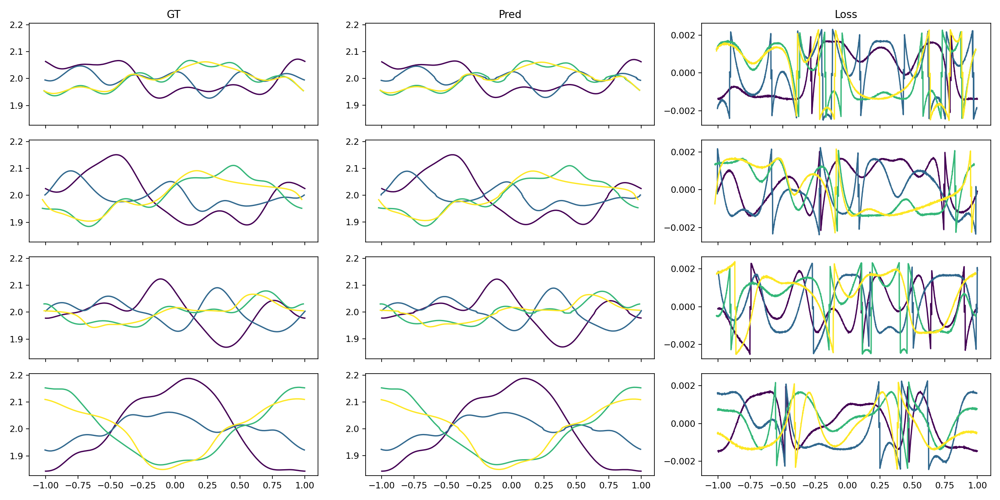

,label,seed,window,file,basis,n,entry,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
0,ffourier x 8 @ [1],474063917,None,perlin_778030991,ffourier,8,0,8,1,1,0.999421,1.365823e-06,64.973760,5.684342e-14,0.000005,6.697837e-07,0.000002,8.064135e-07
1,ffourier x 8 @ [1],474063917,None,perlin_778030991,ffourier,8,1,8,1,1,0.997749,1.602628e-06,64.173511,2.273737e-13,0.000006,1.945468e-07,0.000003,1.549460e-06
2,ffourier x 8 @ [1],474063917,None,perlin_778030991,ffourier,8,2,8,1,1,0.998968,1.528261e-06,64.465253,2.273737e-13,0.000006,7.007200e-07,0.000002,1.112531e-06
3,ffourier x 8 @ [1],474063917,None,perlin_778030991,ffourier,8,3,8,1,1,0.998590,1.721264e-06,63.927269,2.273737e-13,0.000006,5.727504e-07,0.000002,1.382842e-06
4,ffourier x 8 @ [1],474063917,None,perlin_297699213,ffourier,8,0,8,1,1,0.999836,1.108219e-06,66.205503,2.046363e-12,0.000005,3.772004e-07,0.000002,8.870854e-07
5,ffourier x 8 @ [1],474063917,None,perlin_297699213,ffourier,8,1,8,1,1,0.999273,1.089802e-06,66.032972,1.151079e-12,0.000006,1.394671e-07,0.000002,1.039545e-06
6,ffourier x 8 @ [1],474063917,None,perlin_297699213,ffourier,8,2,8,1,1,0.999688,1.259620e-06,65.487487,1.841727e-11,0.000005,5.233389e-07,0.000002,8.006638e-07
7,ffourier x 8 @ [1],474063917,None,perlin_297699213,ffourier,8,3,8,1,1,0.999635,1.177635e-06,65.699048,5.115908e-13,0.000005,3.632742e-07,0.000002,8.900312e-07
8,ffourier x 8 @ [1],474063917,None,perlin_873099211,ffourier,8,0,8,1,1,0.999705,1.114709e-06,66.068303,3.552714e-13,0.000006,1.144176e-07,0.000002,1.244743e-06
9,ffourier x 8 @ [1],474063917,None,perlin_873099211,ffourier,8,1,8,1,1,0.999288,1.507104e-06,64.623938,1.035971e-11,0.000006,4.436651e-07,0.000002,1.172662e-06


In [39]:
basis = 'ffourier'
window = None
windowFn = getWindowFunction(window)
n = 8
trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                          n = n, basis = basis, layers = [1], seed = seeds[0],
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 100,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
# plotModel(trainedModel, testData, device, baseArea, particleSupport)
# plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
df = getTestingLossFrame(trainedModel, testData, plot = True)
display(df)

In [40]:
# model = trainedModel['model']

# positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
# i, j, distance, direction = batchedNeighborsearch(positions, setup)
# x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

# x = x[:,None].to(device)    
# groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity, i, j, distance, direction).to(device)
# distance = (distance * direction)[:,None].to(device)
# features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)

# # optimizer.zero_grad()
# prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
# lossTerm = lossFn(prediction, groundTruth)
# loss = torch.mean(lossTerm)

# nis = model.ni.reshape(batchSize, positions[0].shape[0])

# fig, axis = plt.subplots(1,3, figsize=(16,4), sharex = True, sharey = 'col', squeeze = False)

# for p, ni in zip(positions, nis):
#     axis[0,0].plot(p ,ni)

# fig.tight_layout()

In [41]:
window = 'poly6'
window = None
windowFn = getWindowFunction(window)

In [45]:
basis = 'dmcf'
ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []


for n in tqdm(ns, leave = False):
    for l in tqdm(layouts, leave = False):
        for s in tqdm(seeds, leave = False):
            trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                              n = n, basis = basis, layers = l, seed = s,
                             window = window, windowNorm = windowNorm,
                             epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                             groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    #         models.append(trainedModel)
            df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [46]:
basis = 'abf cubic_spline'
ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []


for n in tqdm(ns, leave = False):
    for l in tqdm(layouts, leave = False):
        for s in tqdm(seeds, leave = False):
            trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                              n = n, basis = basis, layers = l, seed = s,
                             window = window, windowNorm = windowNorm,
                             epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                             groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    #         models.append(trainedModel)
            df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [47]:
basis = 'chebyshev'
ns = [1,2,3,4,5,6,7,8,16,32]
# ns = [4]
widths = [1][::-1]
depths = [0][::-1]
# widths = [16]
# depths = [3]

layouts = []
for d in depths:
    for w in widths:
        l = [w] * d + [1]
        if l not in layouts:
#             print([w] * d + [1])
            layouts.append(l)
# print(layouts)
# print(len(layouts) * len(seeds) * len(ns))
dataset = pandas.DataFrame()
# models = []


for n in tqdm(ns, leave = False):
    for l in tqdm(layouts, leave = False):
        for s in tqdm(seeds, leave = False):
            trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 1, offset = offset,
                              n = n, basis = basis, layers = l, seed = s,
                             window = window, windowNorm = windowNorm,
                             epochs = 5, iterations = 1000, initialLR = 1e-3, device = device, testInterval = 1000,
                             groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    #         models.append(trainedModel)
            df = getTestingLossFrame(trainedModel, testData, plot = False)
            dataset = pandas.concat([dataset, df])
            dataset.to_csv('ablationStudy_density_%s ns %s ws %s ds %s seeds %s.csv' % (basis, '[' + ' '.join([str(d) for d in ns]) + ']', '[' + ' '.join([str(d) for d in widths]) + ']', '[' + ' '.join([str(d) for d in depths]) + ']', '[' + ' '.join([str(d) for d in seeds]) + ']'))

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,n,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,,,,
"linear x 1 @ [16, 16, 16, 16, 16, 1]",1.0,2818.0,6.0,16.0,0.860909,0.145052,17.470102,2.320507e-07,0.771349,0.024483,0.201019,0.176844
"linear x 1 @ [16, 16, 16, 16, 1]",1.0,2274.0,5.0,16.0,0.866299,0.137971,17.514463,9.818145e-08,0.742006,0.022427,0.190322,0.172172
"linear x 1 @ [16, 16, 16, 1]",1.0,1730.0,4.0,16.0,0.869985,0.133305,17.609250,3.640322e-07,0.750874,0.021232,0.182497,0.169258
"linear x 1 @ [16, 16, 1]",1.0,1186.0,3.0,16.0,0.868220,0.133751,17.571456,8.175422e-08,0.754849,0.021204,0.182185,0.170031
"linear x 1 @ [16, 1]",1.0,162.0,2.0,16.0,0.868883,0.133329,17.600783,7.634144e-08,0.733847,0.020886,0.182041,0.168480
"linear x 2 @ [16, 16, 16, 16, 16, 1]",2.0,4146.0,6.0,16.0,0.882326,0.119257,18.008958,1.201237e-07,0.734621,0.015980,0.155887,0.158698
"linear x 2 @ [16, 16, 16, 16, 1]",2.0,3346.0,5.0,16.0,0.881195,0.118521,18.025204,2.215380e-08,0.828900,0.016985,0.152314,0.160234
"linear x 2 @ [16, 16, 16, 1]",2.0,2546.0,4.0,16.0,0.882665,0.117483,18.158303,1.233884e-07,0.728301,0.016768,0.151994,0.154874
"linear x 2 @ [16, 16, 1]",2.0,1746.0,3.0,16.0,0.874255,0.126860,17.837041,1.415285e-07,0.791132,0.018359,0.163973,0.169853


<IPython.core.display.Javascript object>


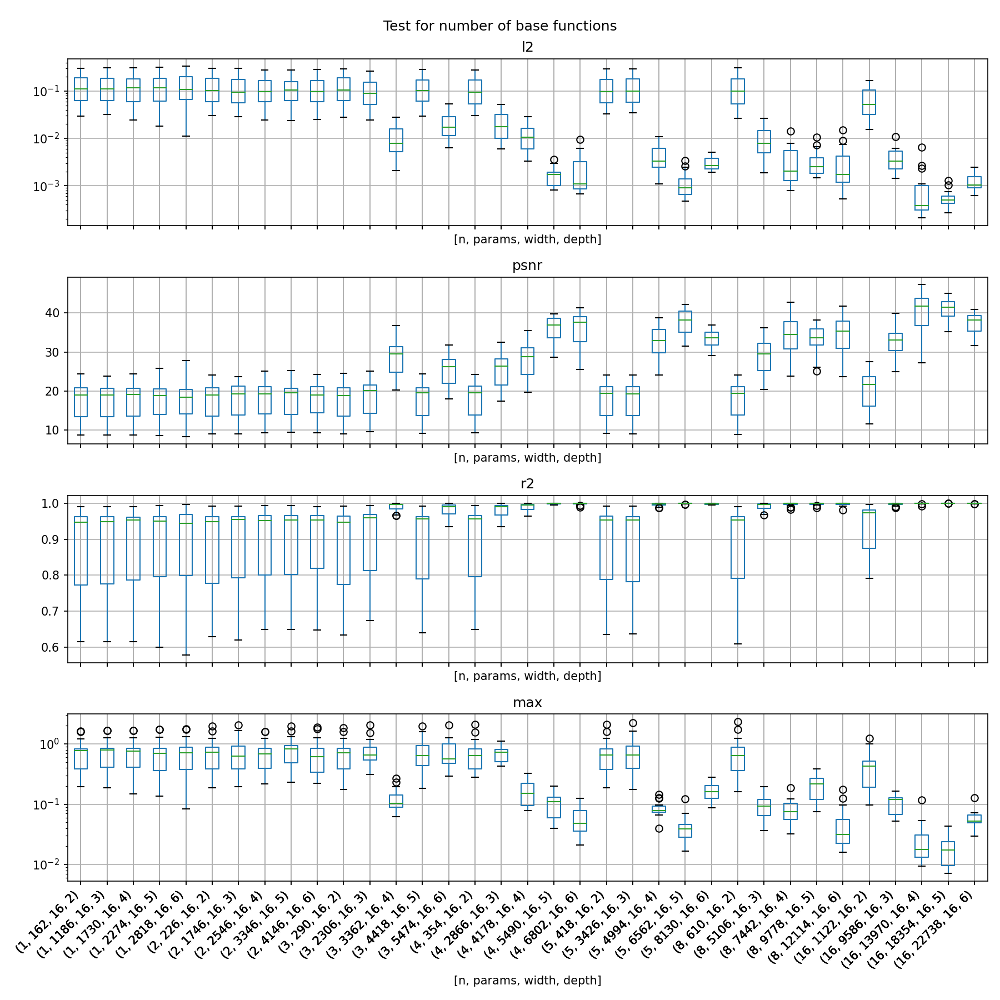

/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, layout keyword is ignored.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))


In [44]:
dataset = pandas.DataFrame()
for trainedModel in models:
    df = getTestingLossFrame(trainedModel, testData, plot = False)
    dataset = pandas.concat([dataset, df])
display(dataset.groupby(['label']).mean(numeric_only = True))

fig, axis = plt.subplots(4,1, figsize=(12,12), sharex = True, sharey = False, squeeze = False)

dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
# dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['params'], ax = axis, layout=(4,1),figsize=(18,12))
# axis[0,0].set_xticks(axis[1,0].get_xticks(), axis[1,0].get_xticklabels(), rotation=45, ha='right')
axis[3,0].set_xticks(axis[3,0].get_xticks(), axis[3,0].get_xticklabels(), rotation=45, ha='right')
axis[0,0].set_yscale('log')
# axis[1,0].set_yscale('log')
axis[3,0].set_yscale('log')
fig.suptitle('Test for number of base functions')
fig.tight_layout()

,n,params,depth,width,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,,,,
"fourier x 1 @ [16, 16, 16, 16, 16, 1]",1.0,2818.0,6.0,16.0,0.866758,0.135689,17.548534,2.246528e-07,0.744215,0.021835,0.186251,0.170716
"fourier x 1 @ [16, 16, 16, 16, 1]",1.0,2274.0,5.0,16.0,0.867719,0.133922,17.582340,1.357756e-07,0.741408,0.021744,0.182241,0.169905
"fourier x 1 @ [16, 16, 16, 1]",1.0,1730.0,4.0,16.0,0.870918,0.131541,17.651016,2.215031e-07,0.739078,0.020158,0.180500,0.167106
"fourier x 1 @ [16, 16, 1]",1.0,1186.0,3.0,16.0,0.867567,0.134916,17.545863,1.146005e-07,0.739253,0.022040,0.183892,0.169940
"fourier x 1 @ [16, 1]",1.0,162.0,2.0,16.0,0.869800,0.133184,17.596151,1.586803e-07,0.730224,0.021607,0.183648,0.168140
"fourier x 2 @ [16, 16, 16, 16, 16, 1]",2.0,4146.0,6.0,16.0,0.999190,0.000850,39.821423,4.005443e-10,0.019076,0.000057,0.000886,0.001788
"fourier x 2 @ [16, 16, 16, 16, 1]",2.0,3346.0,5.0,16.0,0.999004,0.000968,39.438621,6.106678e-10,0.024759,0.000058,0.000959,0.002251
"fourier x 2 @ [16, 16, 16, 1]",2.0,2546.0,4.0,16.0,0.999038,0.000980,39.211341,4.601828e-10,0.023474,0.000061,0.001019,0.002150
"fourier x 2 @ [16, 16, 1]",2.0,1746.0,3.0,16.0,0.997856,0.001966,36.383333,2.108299e-09,0.058601,0.000109,0.001451,0.005321


<IPython.core.display.Javascript object>


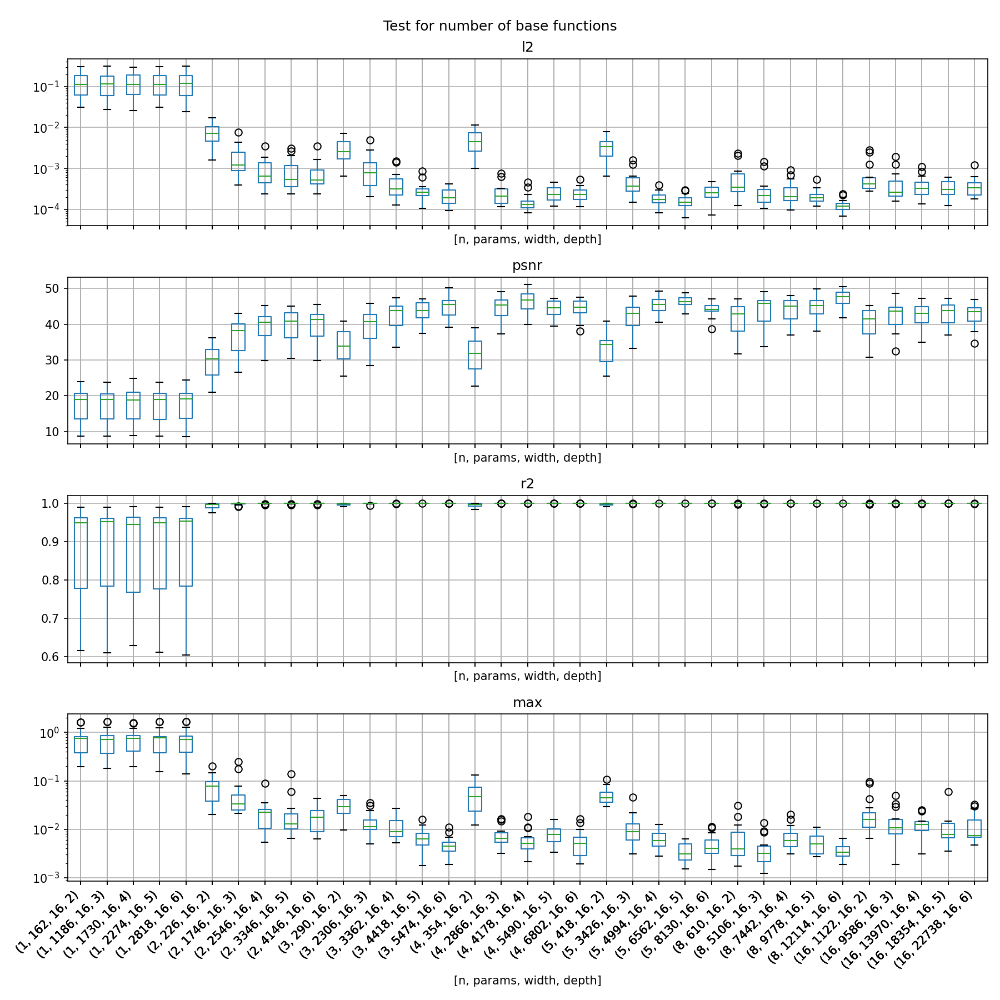

/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, layout keyword is ignored.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
/tmp/ipykernel_202988/2425664662.py:9: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))


In [42]:
dataset = pandas.DataFrame()
for trainedModel in models:
    df = getTestingLossFrame(trainedModel, testData, plot = False)
    dataset = pandas.concat([dataset, df])
display(dataset.groupby(['label']).mean(numeric_only = True))

fig, axis = plt.subplots(4,1, figsize=(12,12), sharex = True, sharey = False, squeeze = False)

dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['n','params','width','depth'], ax = axis, layout=(4,1),figsize=(18,12))
# dataset.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['params'], ax = axis, layout=(4,1),figsize=(18,12))
# axis[0,0].set_xticks(axis[1,0].get_xticks(), axis[1,0].get_xticklabels(), rotation=45, ha='right')
axis[3,0].set_xticks(axis[3,0].get_xticks(), axis[3,0].get_xticklabels(), rotation=45, ha='right')
axis[0,0].set_yscale('log')
# axis[1,0].set_yscale('log')
axis[3,0].set_yscale('log')
fig.suptitle('Test for number of base functions')
fig.tight_layout()

,params,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,
"fourier x 1 @ [16, 16, 16, 1]",1730.0,0.861399,0.121055,16.359826,8.982784e-08,0.569938,0.015655,0.174128,0.146505
"fourier x 2 @ [16, 16, 16, 1]",2546.0,0.999100,0.000821,38.502220,3.001605e-10,0.013004,0.000084,0.001045,0.001285
"fourier x 3 @ [16, 16, 16, 1]",3362.0,0.999542,0.000433,41.403333,4.035574e-10,0.008908,0.000033,0.000443,0.000835
"fourier x 4 @ [16, 16, 16, 1]",4178.0,0.999722,0.000303,43.552836,5.936429e-11,0.007079,0.000017,0.000230,0.000705
"fourier x 5 @ [16, 16, 16, 1]",4994.0,0.999477,0.000500,40.998498,2.540853e-10,0.011390,0.000036,0.000562,0.000947
"fourier x 8 @ [16, 16, 16, 1]",7442.0,0.999683,0.000307,43.285029,2.195288e-10,0.007416,0.000021,0.000318,0.000598
"fourier x 16 @ [16, 16, 16, 1]",13970.0,0.999705,0.000303,42.752053,1.183473e-10,0.006504,0.000023,0.000362,0.000535


<IPython.core.display.Javascript object>


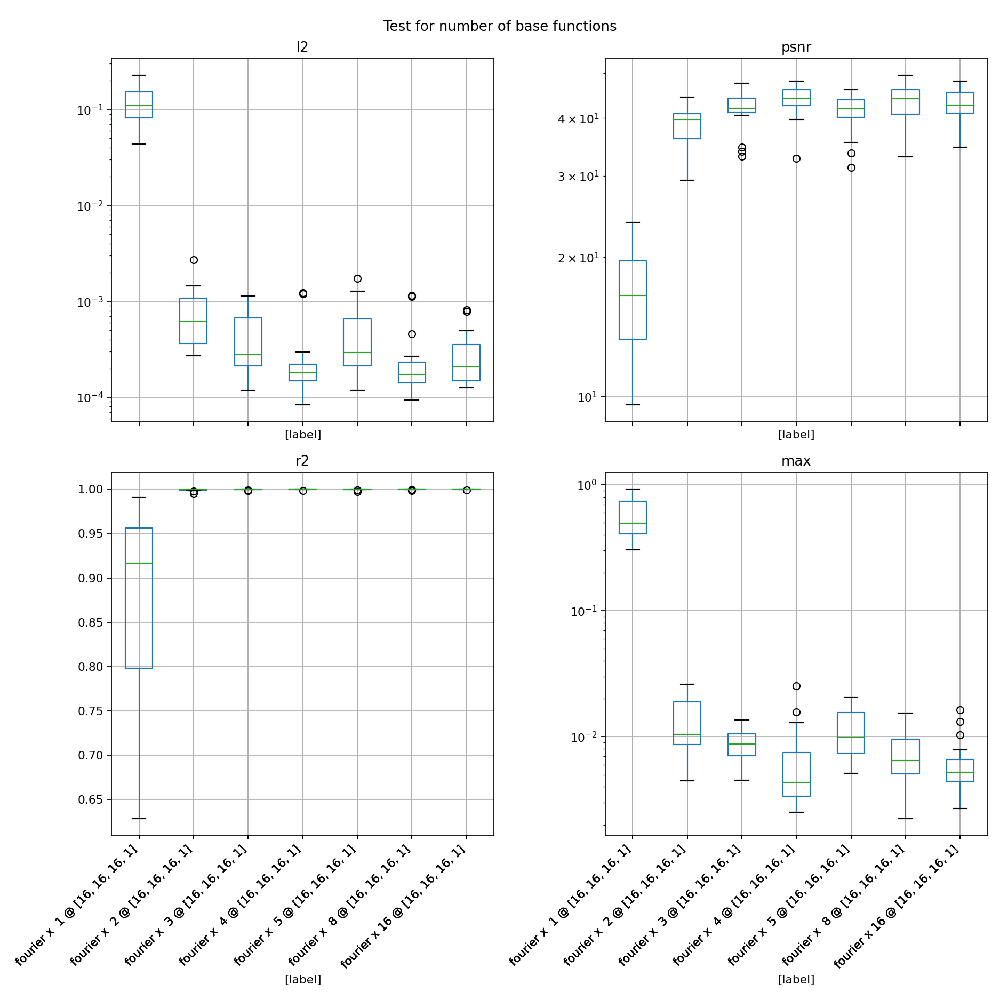

/tmp/ipykernel_619/3739864961.py:3: UserWarning: When passing multiple axes, layout keyword is ignored.
  totalData.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['label'], ax = axis, layout=(2,2),figsize=(12,12))
/tmp/ipykernel_619/3739864961.py:3: UserWarning: When passing multiple axes, sharex and sharey are ignored. These settings must be specified when creating axes.
  totalData.boxplot(column = ['l2', 'psnr', 'r2', 'max'], by = ['label'], ax = axis, layout=(2,2),figsize=(12,12))


<IPython.core.display.Javascript object>


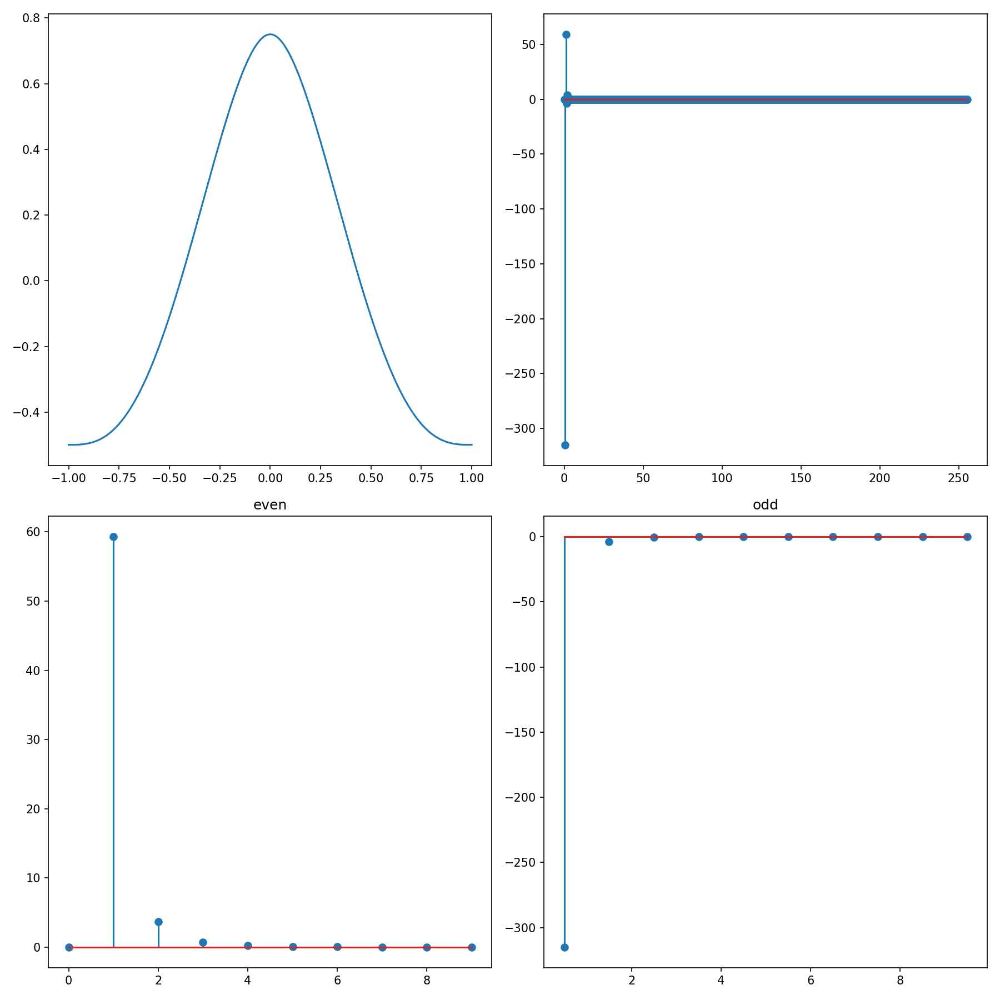

In [104]:
from numpy.fft import *

fx = lambda x: kernel(np.abs(x), 1)
# fx = lambda x: np.cos(x * np.pi)
x = np.linspace(-1,1,1023)
Y = fx(x)

fig, axis = plt.subplots(2,2, figsize=(12,12), sharex = False, sharey = False, squeeze = False)

fourier = rfft(Y - np.mean(Y))
n = len(Y)
timestep = 2 / n
freq = rfftfreq(n, d = timestep)

Y_k = fftshift(fft(Y - np.mean(Y)))
k = fftshift(fftfreq(len(Y)))


axis[0,0].plot(x,Y - np.mean(Y))

axis[0,1].stem(freq,fourier)
# axis[0,1].set_xscale('log')

axis[1,0].set_title('even')
axis[1,0].stem(freq[:20:2], fourier[:20:2])
axis[1,1].set_title('odd')
axis[1,1].stem(freq[1:20:2], fourier[1:20:2])

fig.tight_layout()

In [100]:
print(freq)

[  0.    0.5   1.    1.5   2.    2.5   3.    3.5   4.    4.5   5.    5.5
   6.    6.5   7.    7.5   8.    8.5   9.    9.5  10.   10.5  11.   11.5
  12.   12.5  13.   13.5  14.   14.5  15.   15.5  16.   16.5  17.   17.5
  18.   18.5  19.   19.5  20.   20.5  21.   21.5  22.   22.5  23.   23.5
  24.   24.5  25.   25.5  26.   26.5  27.   27.5  28.   28.5  29.   29.5
  30.   30.5  31.   31.5  32.   32.5  33.   33.5  34.   34.5  35.   35.5
  36.   36.5  37.   37.5  38.   38.5  39.   39.5  40.   40.5  41.   41.5
  42.   42.5  43.   43.5  44.   44.5  45.   45.5  46.   46.5  47.   47.5
  48.   48.5  49.   49.5  50.   50.5  51.   51.5  52.   52.5  53.   53.5
  54.   54.5  55.   55.5  56.   56.5  57.   57.5  58.   58.5  59.   59.5
  60.   60.5  61.   61.5  62.   62.5  63.   63.5  64.   64.5  65.   65.5
  66.   66.5  67.   67.5  68.   68.5  69.   69.5  70.   70.5  71.   71.5
  72.   72.5  73.   73.5  74.   74.5  75.   75.5  76.   76.5  77.   77.5
  78.   78.5  79.   79.5  80.   80.5  81.   81.5  8

In [212]:
totalData

,label,file,entry,params,r2,l2,psnr,min,max,q1,q3,std
0,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,0,1730,0.673548,0.108647,12.535899,8.820606e-08,0.662982,0.006923,0.091369,0.176767
1,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,1,1730,0.911366,0.099613,14.803907,9.010142e-08,0.452018,0.015787,0.132182,0.120403
2,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,2,1730,0.839347,0.087493,15.211680,1.404084e-08,0.382198,0.016373,0.121194,0.094003
3,"fourier x 1 @ [16, 16, 16, 1]",perlin_778030991,3,1730,0.912167,0.048292,16.165241,2.513758e-08,0.303613,0.009692,0.050593,0.067070
4,"fourier x 1 @ [16, 16, 16, 1]",perlin_297699213,0,1730,0.648929,0.204711,10.878497,2.864484e-07,0.859421,0.044797,0.238153,0.233947
...,...,...,...,...,...,...,...,...,...,...,...,...
11,"fourier x 16 @ [16, 16, 16, 1]",perlin_873099211,3,13970,0.999903,0.000131,47.736695,4.259793e-11,0.002860,0.000010,0.000138,0.000269
12,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,0,13970,0.998679,0.000811,34.556552,2.686740e-10,0.007870,0.000058,0.001187,0.001162
13,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,1,13970,0.999938,0.000497,45.321384,5.798597e-10,0.016416,0.000042,0.000704,0.000855
14,"fourier x 16 @ [16, 16, 16, 1]",perlin_46852263,2,13970,0.999808,0.000434,42.977249,3.660752e-10,0.006000,0.000031,0.000478,0.000721


In [193]:
totalData = pandas.DataFrame()

In [194]:
df = getTestingLossFrame(trainedModel, testData, plot = False)

In [208]:
pandas.concat([totalData, df])

,label,file,entry,params,r2,l2,psnr,min,max,q1,q3,std
0,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,0,21218,0.999800,0.000066,44.667909,1.195133e-11,0.002828,0.000006,0.000086,0.000133
1,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,1,21218,0.999844,0.000175,42.348853,1.945466e-11,0.005499,0.000019,0.000203,0.000310
2,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,2,21218,0.999672,0.000178,42.117259,5.684342e-12,0.003941,0.000014,0.000222,0.000308
3,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_778030991,3,21218,0.999792,0.000115,42.411880,1.841727e-11,0.002514,0.000008,0.000124,0.000199
4,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,0,21218,0.999681,0.000186,41.297465,1.421085e-12,0.003914,0.000009,0.000143,0.000451
5,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,1,21218,0.999937,0.000206,46.006468,1.478497e-10,0.002808,0.000032,0.000291,0.000247
6,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,2,21218,0.999887,0.000160,45.345182,4.916387e-10,0.002369,0.000021,0.000235,0.000207
7,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_297699213,3,21218,0.999914,0.000155,47.321225,1.547562e-11,0.002023,0.000011,0.000202,0.000225
8,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_873099211,0,21218,0.999747,0.000152,41.009333,8.460574e-10,0.003046,0.000023,0.000165,0.000266
9,"fourier x 4 @ [32, 32, 32, 32, 1]",perlin_873099211,1,21218,0.999877,0.000151,44.067332,6.878054e-12,0.005630,0.000012,0.000171,0.000347


In [213]:
df.groupby(['label']).mean(numeric_only = True)
# fig, axis = plt.subplots(1,4, figsize=(8,4), sharex = False, sharey = False, squeeze = False)


# df.boxplot(column = ['r2', 'l2', 'max', 'psnr'], by = ['label'], ax = axis, layout=(1,4),figsize=(8,4))

# fig.tight_layout()


,params,r2,l2,psnr,min,max,q1,q3,std
label,,,,,,,,,
"fourier x 16 @ [16, 16, 16, 1]",13970.0,0.999705,0.000303,42.752044,1.258857e-10,0.006504,0.000023,0.000362,0.000535


In [112]:
modelState = trainedModel


In [113]:

#     with torch.no_grad():
#         for i, k in  enumerate(testData.keys()):
#             ax = axis['B']
#             if i == 0:
#                 ax = axis['B']
#             if i == 1:
#                 ax = axis['C']
#             if i == 2:
#                 ax = axis['G']
#             if i == 3:
#                 ax = axis['H']    
#             norm = mpl.colors.Normalize(vmin=0, vmax=len(testData[k][0]) - 1)
#             gt = testData[k][9].reshape(len(testData[k][0]), testData[k][0][0].shape[0])
#             for i, (xs, rhos) in enumerate(zip(testData[k][0], gt)):
#                 c = cmap(norm(i))
#                 ax.plot(xs.cpu().numpy(), rhos.cpu().numpy(), c = c)
#             prediction = modelState['model'](testData[k][5], testData[k][6], testData[k][7], testData[k][8]).reshape(len(testData[k][0]), testData[k][0][0].shape[0]).detach().cpu().numpy()
#             for i, (xs, rhos) in enumerate(zip(testData[k][0], prediction)):
#                 c = cmap(norm(i))
#                 ax.plot(xs.cpu().numpy(), rhos, ls = '--', c = c)

In [154]:
print('%s x %2d @ %s' % (modelState['basis'], modelState['n'], str(modelState['layers'])))

fourier x  4 @ [16, 32, 32, 16, 1]


<IPython.core.display.Javascript object>


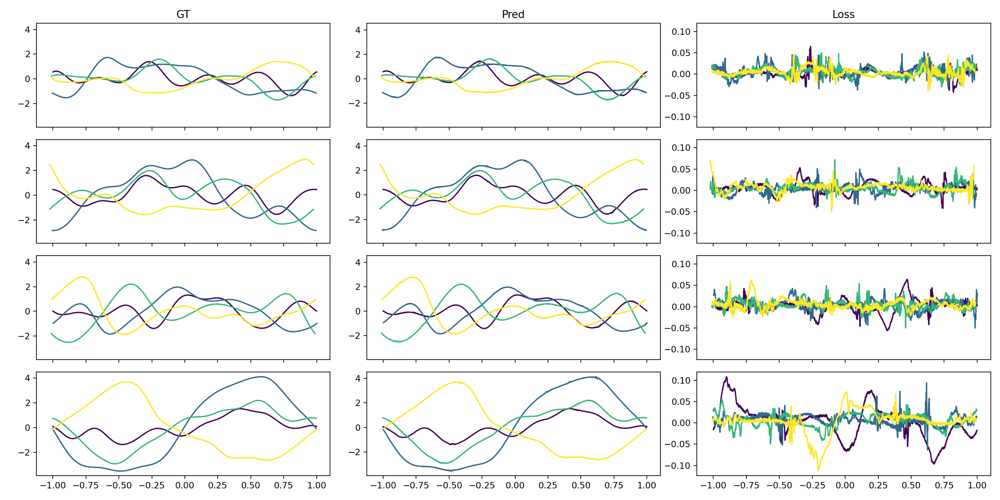

In [150]:
df = pandas.DataFrame(data = lossDict)
df
# fig, axis = plt.subplots(1,1, figsize=(8,4), sharex = False, sharey = False, squeeze = False)

# fig.tight_layout()

,r2,l2,psnr,min,max,q1,q3,std
0,0.999683,0.000106,42.657999,7.517542e-12,0.004266,0.000007,0.000100,0.000265
1,0.999820,0.000202,41.731274,2.589928e-10,0.002715,0.000016,0.000255,0.000324
2,0.999756,0.000133,43.393218,4.456524e-11,0.002500,0.000016,0.000156,0.000222
3,0.999775,0.000124,42.077339,6.963319e-11,0.002275,0.000007,0.000114,0.000239
4,0.999650,0.000204,40.894347,4.058762e-10,0.002850,0.000028,0.000206,0.000340
5,0.999953,0.000154,47.273895,2.751221e-11,0.002624,0.000013,0.000206,0.000247
6,0.999897,0.000145,45.782044,1.688392e-10,0.005127,0.000012,0.000153,0.000309
7,0.999907,0.000167,46.980776,1.365663e-11,0.004832,0.000017,0.000182,0.000359
8,0.999501,0.000300,38.050233,1.406910e-10,0.004147,0.000014,0.000230,0.000620
9,0.999870,0.000159,43.833022,2.383196e-10,0.002520,0.000019,0.000176,0.000270


In [96]:
testPredictions['perlin_778030991'].shape

(4, 2048)

In [ ]:
    positions, velocities, areas, dudts, density, inputVelocity, outputVelocity, setup = loadBatch(trainingData, settings, dataSet, bdata, device, offset)
    i, j, distance, direction = batchedNeighborsearch(positions, setup)
    x, u, v, rho, dudt, inVel, outVel = flatten(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity)

    x = x[:,None].to(device)    
    groundTruth = groundTruthFn(positions, velocities, areas, density, dudts, inputVelocity, outputVelocity).to(device)
    distance = (distance * direction)[:,None].to(device)
    features = featureFn(x, u, v, rho, dudt, inVel, outVel).to(device)
    
    with torch.no_grad():
        prediction = modelState['model'](features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
  

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

  0%|          | 0/2000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


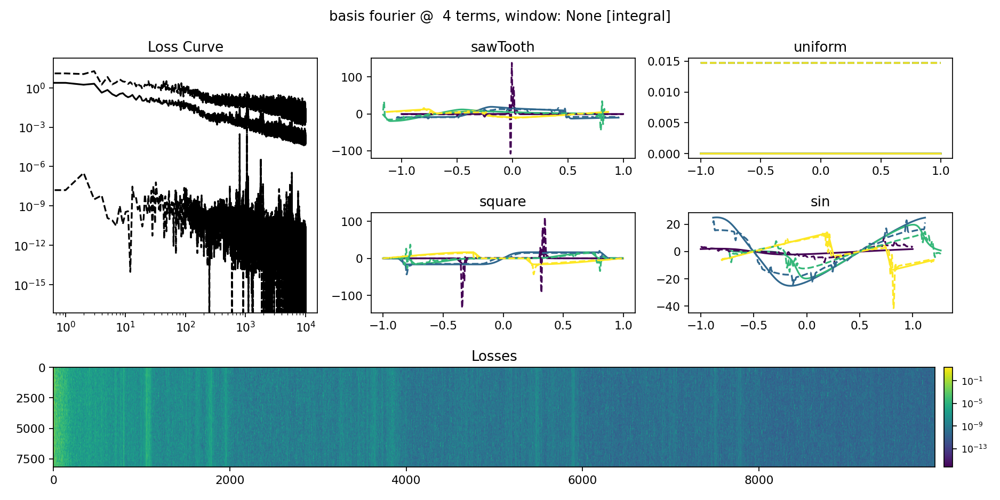

<IPython.core.display.Javascript object>


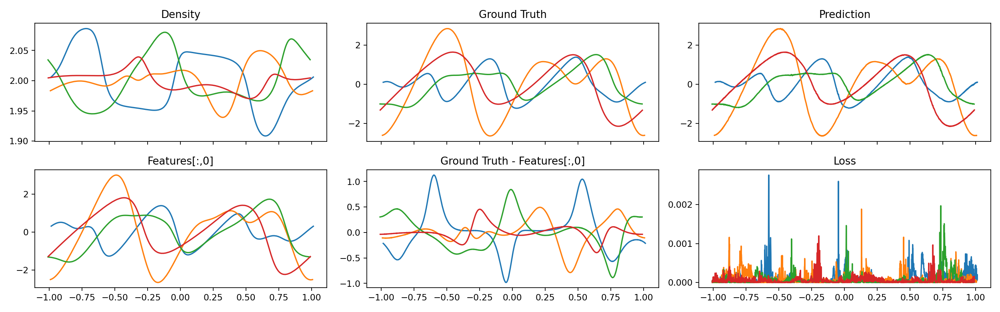

In [30]:
basis = 'fourier'
n = 4
trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles, fluidFeatures = 3, offset = offset,
                          n = n, basis = basis, layers = [16,32,32,16,1],
                         window = window, windowNorm = windowNorm,
                         epochs = 5, iterations = 2000, initialLR = 1e-3, device = device, testInterval = 10,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
plotModel(trainedModel, testData, device, baseArea, particleSupport)
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


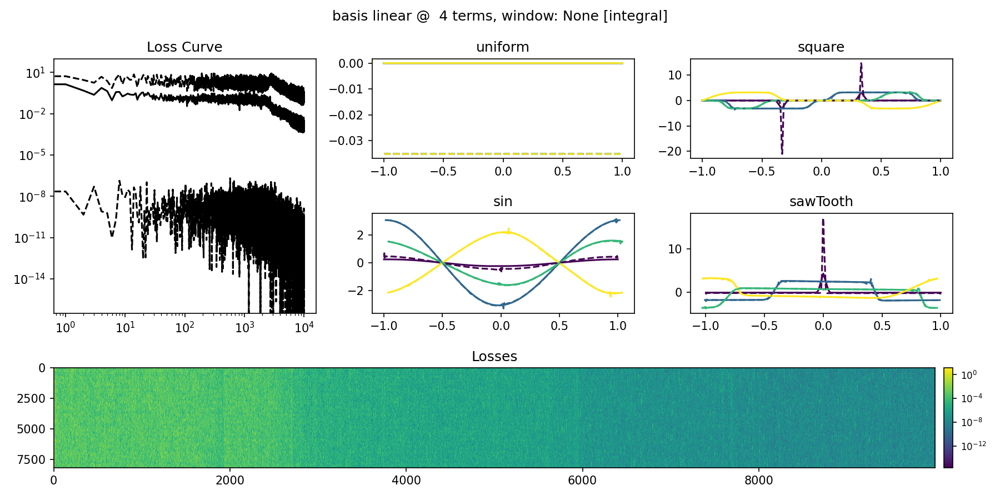

In [99]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


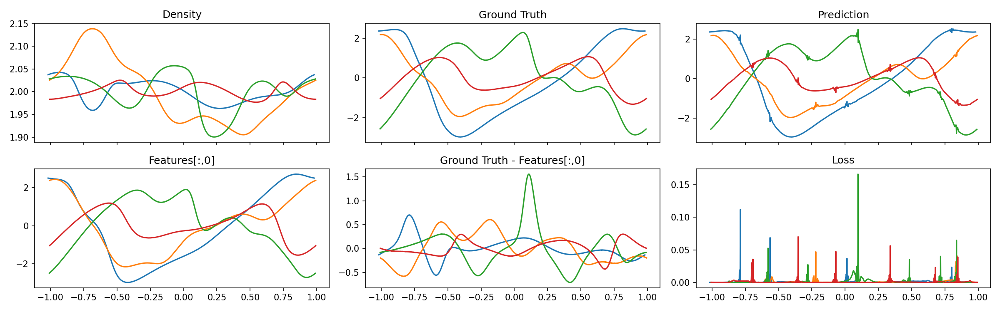

In [100]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


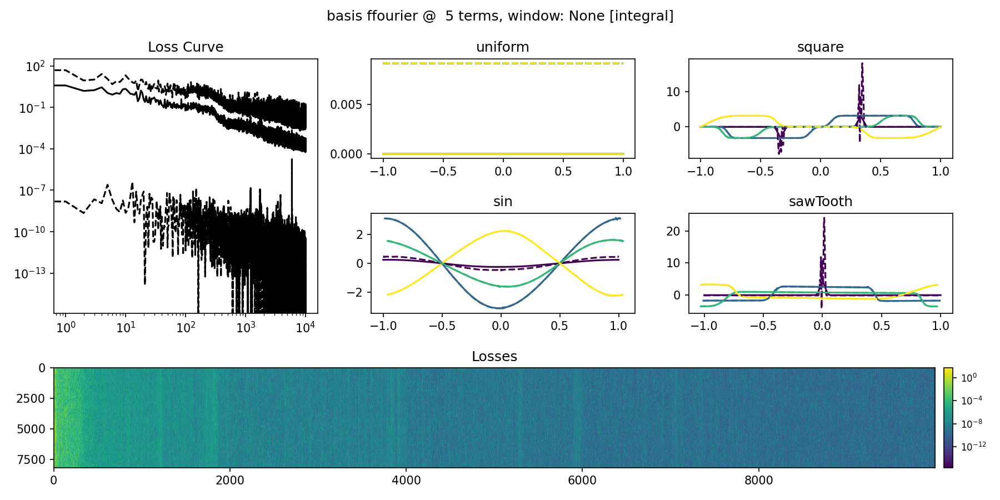

In [85]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


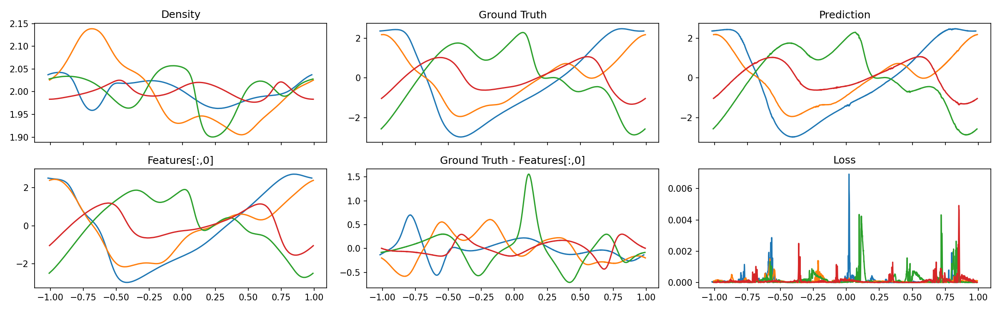

In [86]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


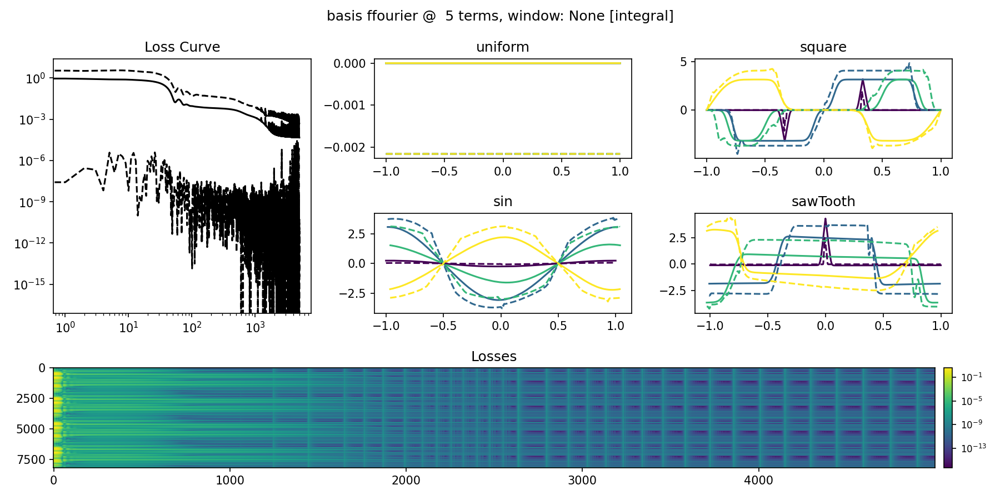

In [80]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


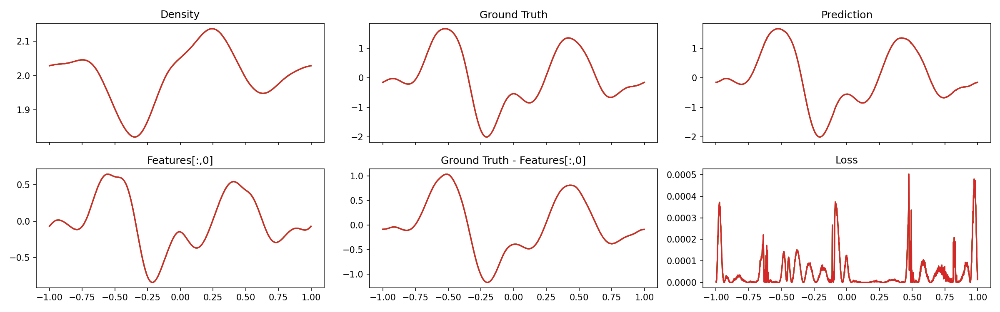

In [81]:
plotTrainedBatch(trainingData, settings, dataSet, bdata, device, offset, trainedModel, groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)

<IPython.core.display.Javascript object>


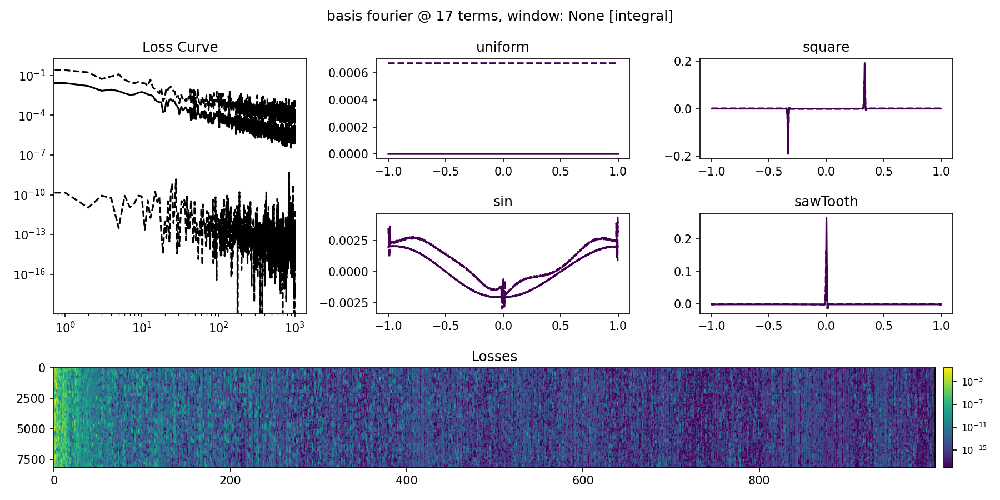

In [188]:
plotModel(trainedModel, testData, device, baseArea, particleSupport)

<IPython.core.display.Javascript object>


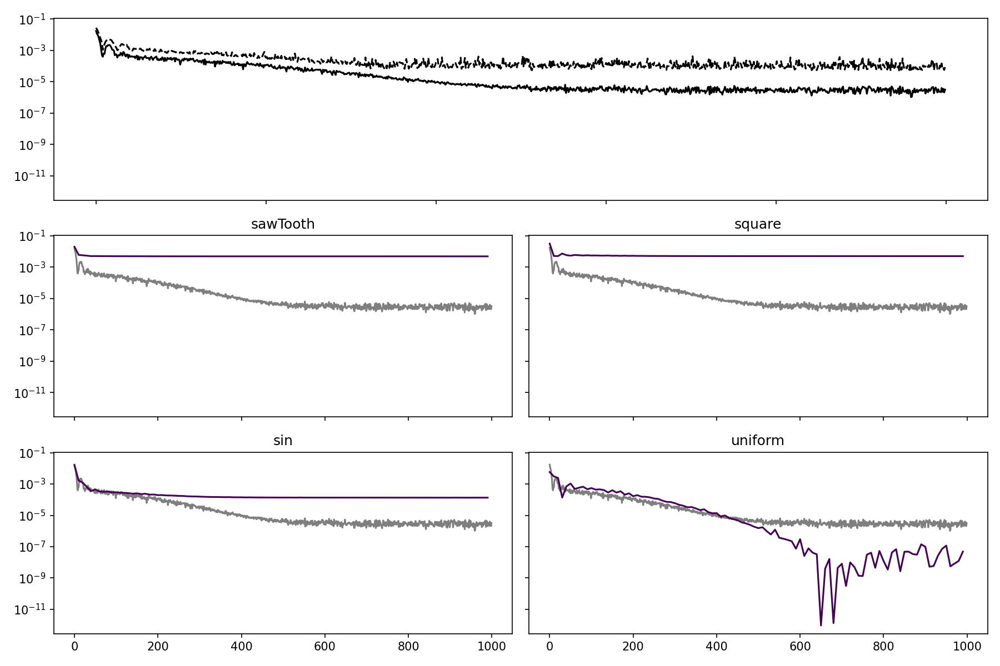

In [26]:
plotLosses(trainedModel, testData)

<IPython.core.display.Javascript object>


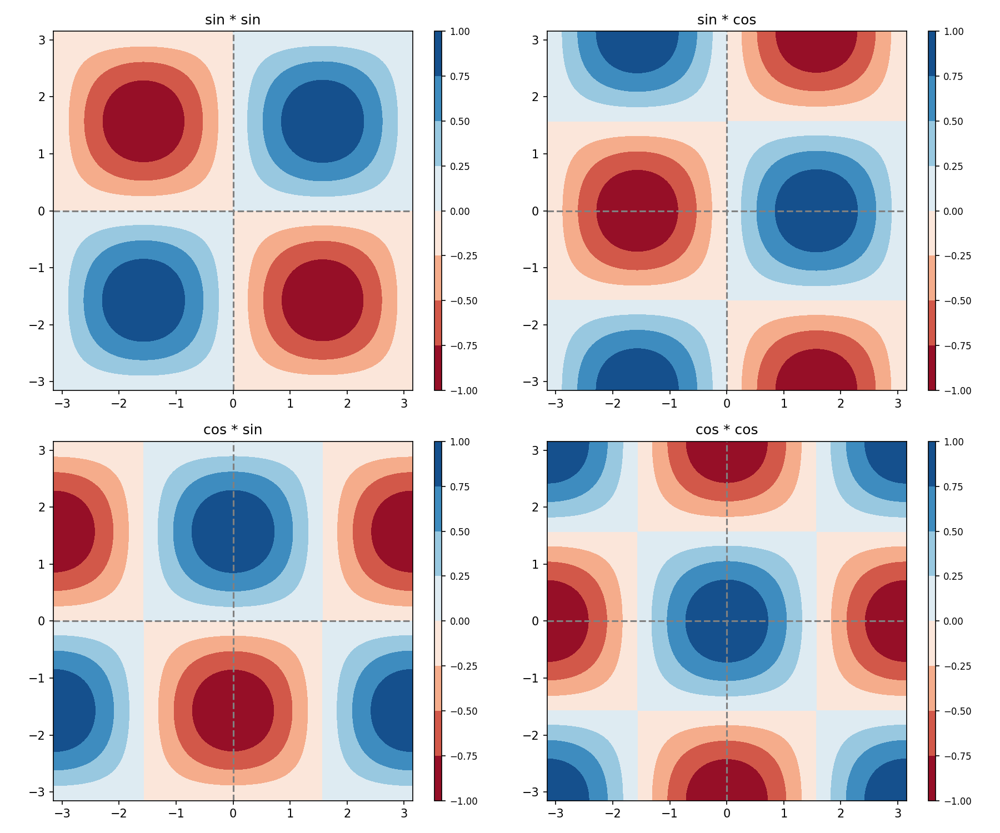

In [118]:
x = np.linspace(-np.pi,np.pi,255)
y = np.linspace(-np.pi,np.pi,255)
xx,yy = np.meshgrid(x,y)

XX = xx.flatten()
YY = yy.flatten()

# zz = xx**2 + yy**2
ZZ1 = (np.sin(xx) * np.sin(yy)).reshape(xx.shape)
ZZ2 = (np.sin(xx) * np.cos(yy)).reshape(xx.shape)
ZZ3 = (np.cos(xx) * np.sin(yy)).reshape(xx.shape)
ZZ4 = (np.cos(xx) * np.cos(yy)).reshape(xx.shape)
# print(zz - ZZ)

fig, axis = plt.subplots(2,2, figsize=(12,10), sharex = False, sharey = False, squeeze = False)

def plotCf(fig, axis, xx,yy,zz, title, cmap = 'RdBu'):
    im = axis.pcolor(xx,yy,zz, cmap = cmap)
    im = axis.contourf(xx,yy,zz, cmap = cmap)
    axis.axis('equal')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
    cb1.ax.tick_params(labelsize=8) 
    axis.axhline(0, ls = '--', c = 'grey') 
    axis.axvline(0, ls = '--', c = 'grey')
    axis.set_title(title)

plotCf(fig, axis[0,0], xx, yy, ZZ1, 'sin * sin')
plotCf(fig, axis[0,1], xx, yy, ZZ2, 'sin * cos')
plotCf(fig, axis[1,0], xx, yy, ZZ3, 'cos * sin')
plotCf(fig, axis[1,1], xx, yy, ZZ4, 'cos * cos')

fig.tight_layout()
# axis[0,0].contourf(xx,yy,xx**2 + yy**2)

<IPython.core.display.Javascript object>


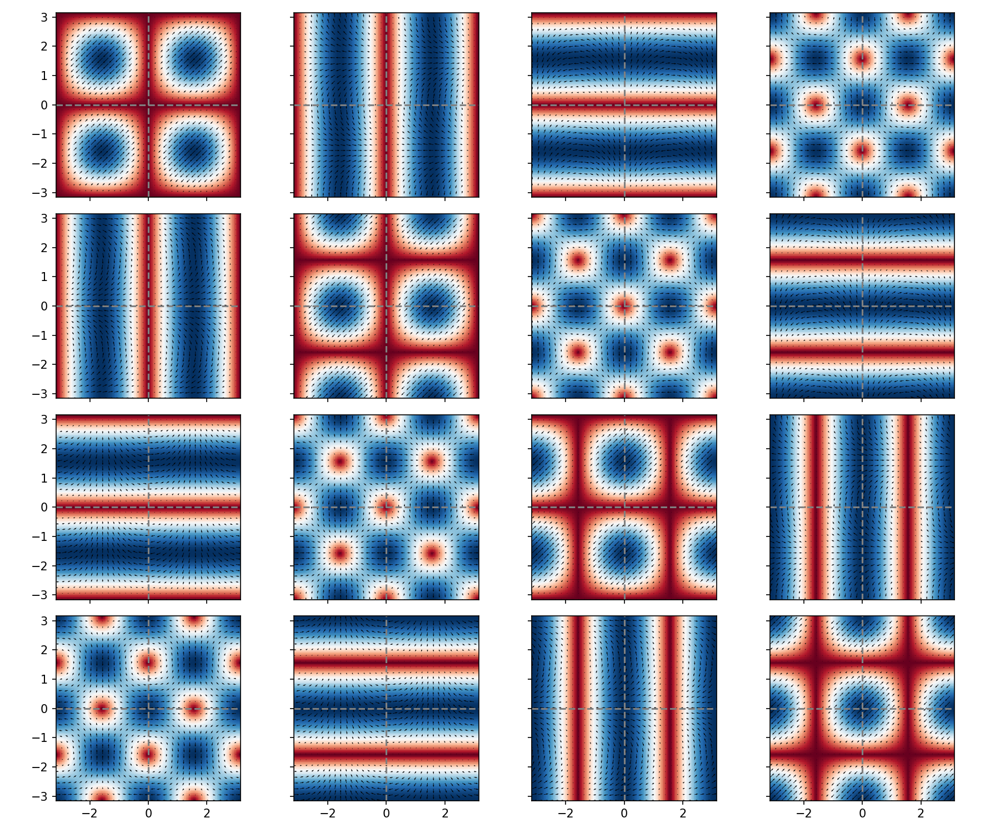

In [141]:

fig, axis = plt.subplots(4,4, figsize=(12,10), sharex = True, sharey = True, squeeze = False)

def plotQuiver(fig, axis, xx,yy,zz1,zz2, title, cmap = 'RdBu'):
    im = axis.pcolor(xx,yy,np.linalg.norm(np.stack((zz1, zz2), axis = -1), axis = -1), cmap = cmap)
#     im = axis.contourf(xx,yy,zz, cmap = cmap)
    axis.quiver(xx[::8,::8],yy[::8,::8],zz1[::8,::8],zz2[::8,::8])
    axis.set_aspect(1)
#     ax1_divider = make_axes_locatable(axis)
#     cax1 = ax1_divider.append_axes("right", size="2%", pad="6%")
#     cb1 = fig.colorbar(im, cax=cax1,orientation='vertical')
#     cb1.ax.tick_params(labelsize=8) 
    axis.axhline(0, ls = '--', c = 'grey') 
    axis.axvline(0, ls = '--', c = 'grey')
#     axis.set_title(title)

zs = [ZZ1, ZZ2, ZZ3, ZZ4]
for i in range(len(zs)):
    for j in range(len(zs)):
        plotQuiver(fig, axis[i,j], xx, yy, zs[i], zs[j], 'sin * sin')
# plotCf(fig, axis[0,1], xx, yy, ZZ2, 'sin * cos')
# plotCf(fig, axis[1,0], xx, yy, ZZ3, 'cos * sin')
# plotCf(fig, axis[1,1], xx, yy, ZZ4, 'cos * cos')

fig.tight_layout()

In [133]:
np.linalg.norm(np.stack((ZZ1, ZZ1), axis = -1), axis = -1)

array([[2.12098062e-32, 4.28378542e-18, 8.56494965e-18, ...,
        8.56494965e-18, 4.28378542e-18, 2.12098062e-32],
       [4.28378542e-18, 8.65204392e-04, 1.72987938e-03, ...,
        1.72987938e-03, 8.65204392e-04, 4.28378542e-18],
       [8.56494965e-18, 1.72987938e-03, 3.45870027e-03, ...,
        3.45870027e-03, 1.72987938e-03, 8.56494965e-18],
       ...,
       [8.56494965e-18, 1.72987938e-03, 3.45870027e-03, ...,
        3.45870027e-03, 1.72987938e-03, 8.56494965e-18],
       [4.28378542e-18, 8.65204392e-04, 1.72987938e-03, ...,
        1.72987938e-03, 8.65204392e-04, 4.28378542e-18],
       [2.12098062e-32, 4.28378542e-18, 8.56494965e-18, ...,
        8.56494965e-18, 4.28378542e-18, 2.12098062e-32]])

In [121]:
print(xx.shape)

(255, 255)


In [57]:
models = []
nMax = 32
for i in tqdm(range(1,nMax + 1)):
    trainedModel = trainModel(particleData, testData, settings, dataSet, trainingFiles,
                          n = i, basis = basis, layers = layers,
                         window = window, windowNorm = windowNorm,
                         epochs = epochs, iterations = 1000, initialLR = 1e-2, device = device, testInterval = 10,
                         groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
    models.append(trainedModel)
#     break

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


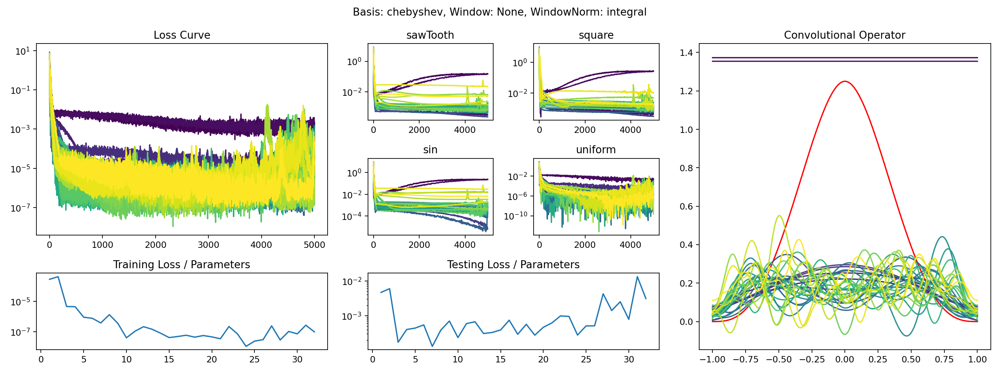

In [51]:
plotModelset2(models, testData, device,nMax)

<IPython.core.display.Javascript object>


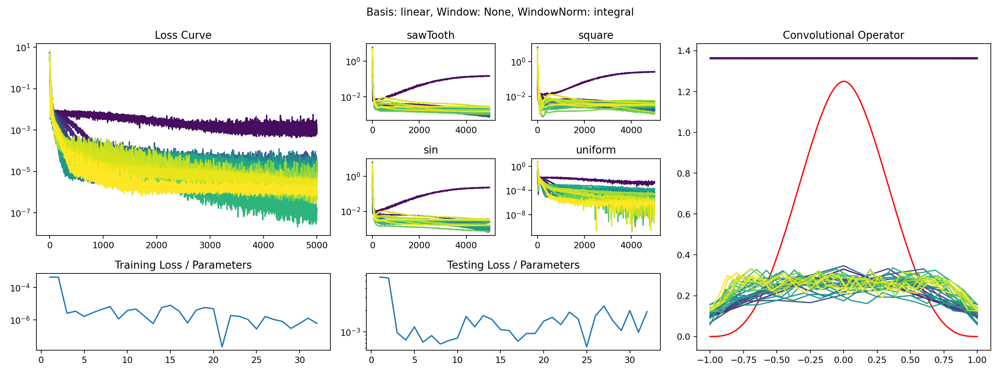

In [58]:
plotModelset2(models, testData, device,nMax)

<IPython.core.display.Javascript object>


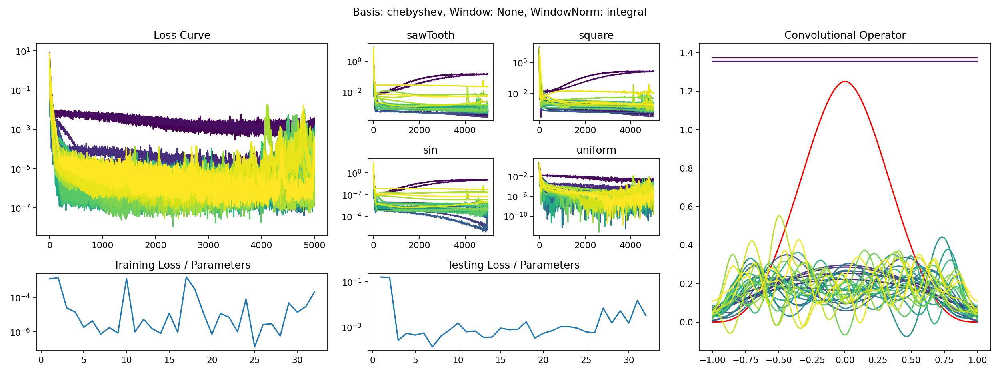

In [47]:
plotModelset2(models, testData, device,nMax)

In [26]:
plotModelset(models, device)

NameError: name 'plotModelset' is not defined

<IPython.core.display.Javascript object>


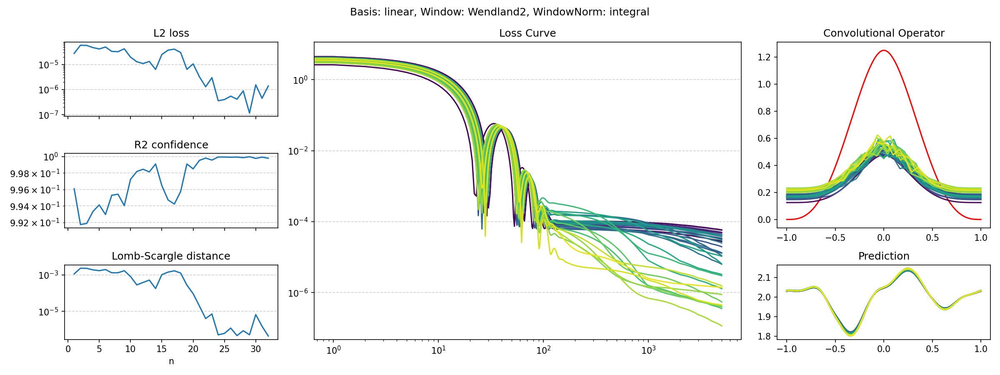

In [29]:
fig, axis = plt.subplot_mosaic('''ABE
CBE
DBF''', figsize=(16,6), sharex = False, width_ratios=[1,2,1])
fig.canvas.draw()
fig.canvas.flush_events()

if not os.path.exists('./images/'):
    os.makedirs('./images/')    
    
basii = ['linear', 'chebyshev', 'fourier', 'rbf cubic_spline', 'abf cubic_spline', 'ubf cubic_spline', 'rbf wendland2', 'rbf square']
windows = [None, 'cubicSpline', 'Wendland2', 'Spiky', 'Linear']

In [ ]:
for basis in tqdm(basii):
    for window in tqdm(windows, leave = False):
        models = []
        for i in tqdm(range(1,32 + 1), leave = False):
            trainedModel = trainModel(particleData, settings, dataSet, trainingFiles,
                                      n = i, basis = basis, layers = [1],
                                 window = window, windowNorm = windowNorm,
                                 epochs = 5, iterations = 1000, initialLR = 1e-2, device = device,
                                 groundTruthFn = getGroundTruth, featureFn = getFeatures, lossFn = lossFunction)
            models.append(trainedModel)
        plotModelsetInteractive(fig, axis, models, device)
        fig.canvas.draw()
        fig.canvas.flush_events()
        fig.savefig('./images/%s_%s_%s.png' % (basis, models[0]['window'] if models[0]['window'] is not None else 'None', models[0]['windowNorm'] if models[0]['windowNorm'] is not None and window is not None else 'None'))
#         print(basis, window)
#         break
#     break

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/32 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


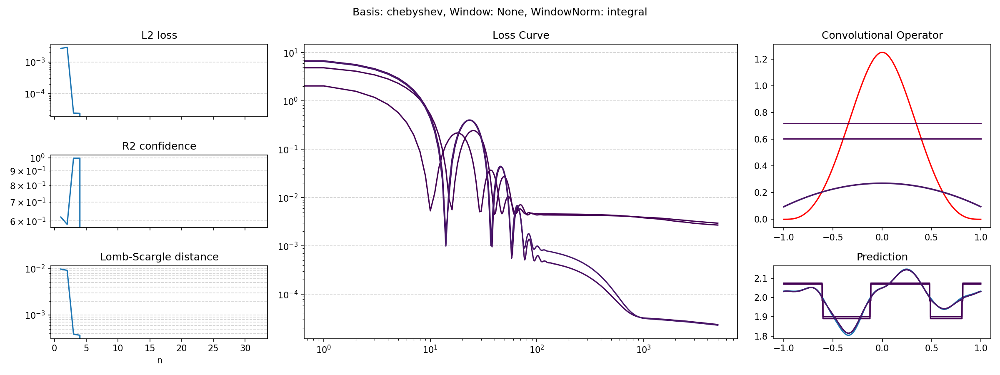

<IPython.core.display.Javascript object>


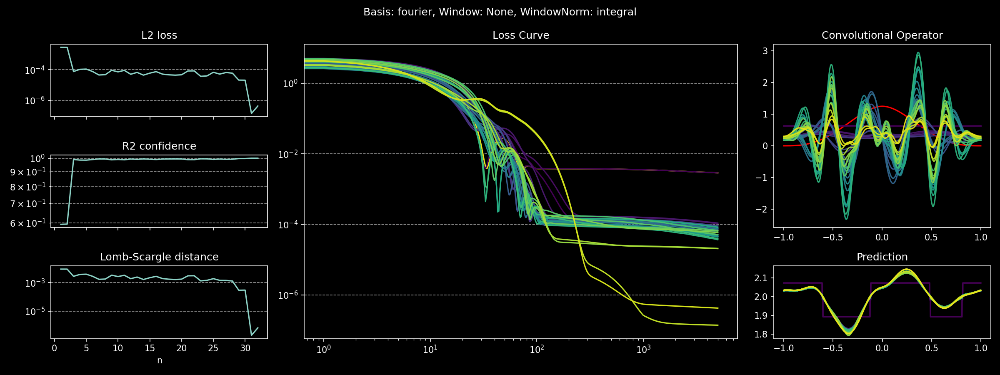

In [129]:
plotModelset(models)

   6.101


<IPython.core.display.Javascript object>


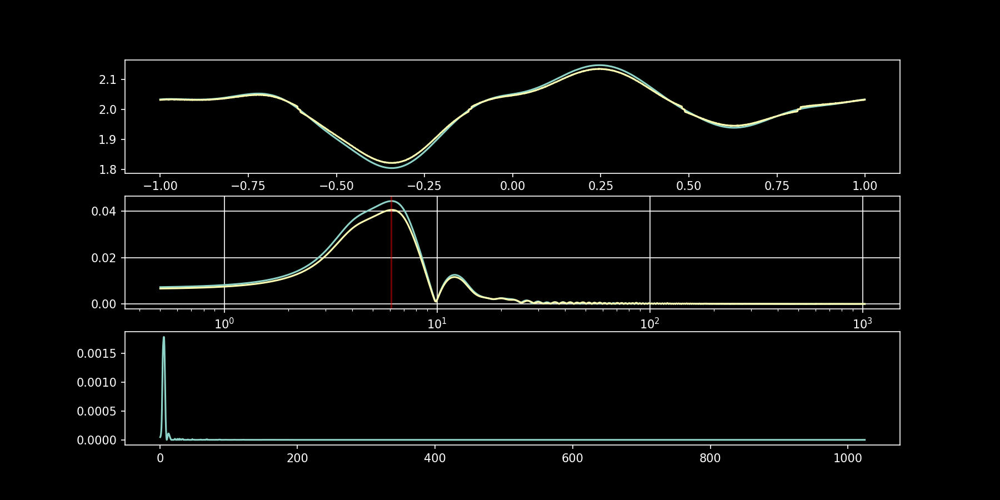

In [46]:
from scipy.signal import lombscargle

x = trainedModel['x'][:,0].numpy()
y = trainedModel['gt'].numpy()
# y = trainedModel['predictions'][-1].numpy()

dxmin = np.diff(x).min()
duration = x.ptp()
x.shape[0]
freqs = np.linspace(1/duration, x.shape[0]/duration, 5*x.shape[0])
periodogram = lombscargle(x, y - np.mean(y), freqs, normalize = False, precenter = True)
periodograma = lombscargle(x, y - np.mean(y), freqs)

kmax = periodogram.argmax()
print("%8.3f" % (freqs[kmax],))

fig, axis = plt.subplots(3, 1, figsize=(12,6), sharex = False, sharey = False, squeeze = False)

axis[0,0].plot(x, y)

axis[1,0].semilogx(freqs, np.sqrt(4*periodogram/(5*x.shape[0])))
axis[1,0].set_xlabel('Frequency (rad/s)')
axis[1,0].grid()
axis[1,0].axvline(freqs[kmax], color='r', alpha=0.25)


y2 = trainedModel['predictions'][-1].numpy()

dxmin = np.diff(x).min()
duration = x.ptp()
freqs = np.linspace(1/duration, x.shape[0]/duration, 5*x.shape[0])
periodogram = lombscargle(x, y2 - np.mean(y), freqs, normalize = False, precenter = True)
periodogramb = lombscargle(x, y2 - np.mean(y), freqs)
axis[0,0].plot(x, y2)
axis[1,0].plot(freqs, np.sqrt(4*periodogram/(5*x.shape[0])))
axis[1,0].axvline(freqs[kmax], color='r', alpha=0.25)

axis[2,0].plot(freqs, (np.sqrt(4*periodograma/(5*n)) - np.sqrt(4*periodogramb/(5*n)))**2)

plt.show()

In [31]:

windowFn = getWindowFunction(window, norm = windowNorm) if window is not None else None


In [32]:
# Setup a single layer neural network using the RbfConv class

    
model = RbfNet(fluidFeatures = 1, 
               layers = [1], 
               denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
               n = n, windowFn = windowFn, rbf = basis, batchSize = computeBatchSize, ignoreCenter = True, normalized = False).to(device)

# model = RbfNet(fluidFeatures = 1, 
#                layers = [1], 
#                denseLayer = True, activation = 'ReLU', coordinateMapping = 'cartesian', 
#                n = n, windowFn = None, rbf = basis, batchSize = computeBatchSize, ignoreCenter = True, normalized = False).to(device)

print('Network has', count_parameters(model), 'parameters')
# Create optimizer for the network
optimizer = Adam(model.parameters(), lr=lr, weight_decay=0)



Network has 18 parameters


In [33]:

# i, j, distance, direction = batchedNeighborsearch(positions, setup)
# x, u, v, dudt = flatten(positions, velocities, density, dudts)
# x = x[:,None]

In [34]:
lr = 1e-2
optimizer.zero_grad()
positions, velocities, areas, dudts, density, setup = loadFrames(particleData, settings, dataSet, trainingFiles[0], 0 + np.arange(1), device)
#                 positions, velocities, areas, dudts, setup = loadBatch(particleData, settings, dataSet, bdata, device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, rho, dudt = flatten(positions, velocities, areas, density, dudts)

x = x[:,None].to(device)
groundTruth = getGroundTruth(positions, velocities, areas, density, dudts).to(device)
distance = (distance * direction)[:,None].to(device)
features = getFeatures(x, u, v, rho, dudt).to(device)

predictions = []
losses = []
for e in (pb := tqdm(range(epochs))):
    for b in (pbl := tqdm(range(iterations), leave=False)):
        optimizer.zero_grad()
        prediction = model(features.to(device), i.to(device), j.to(device), distance.to(device))[:,0]
        lossTerm = lossFunction(prediction, groundTruth)
        loss = torch.mean(lossTerm)

    #     print(prediction)
    #     print(groundTruth)
    #     print(lossTerm)

        loss.backward()
        optimizer.step()
        predictions.append(prediction.detach().cpu())
        losses.append(lossTerm.detach().cpu())
        pbl.set_description('%8s[gpu %d]: %3d [%1d] @ %1.1e: :  %s -> %.2e' %('overfitting', 0, 0, 0, lr, '0', loss.detach().cpu().numpy()))
    
#     break
    if True: #epoch % 1 == 0 and epoch > 0:
        lr = lr * 0.95
        for param_group in optimizer.param_groups:
            param_group['lr'] = 0.5 * param_group['lr']
# store the losses for later processing
# losses.append(lossTerm.detach().cpu().numpy())

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

In [35]:
print(features)

tensor([[1.],
        [1.],
        [1.],
        ...,
        [1.],
        [1.],
        [1.]])


In [36]:
print(prediction)

tensor([2.0315, 2.0318, 2.0319,  ..., 2.0315, 2.0315, 2.0320],
       grad_fn=<SelectBackward0>)


In [37]:
print(groundTruth)

tensor([2.0329, 2.0330, 2.0331,  ..., 2.0326, 2.0327, 2.0328])


<IPython.core.display.Javascript object>


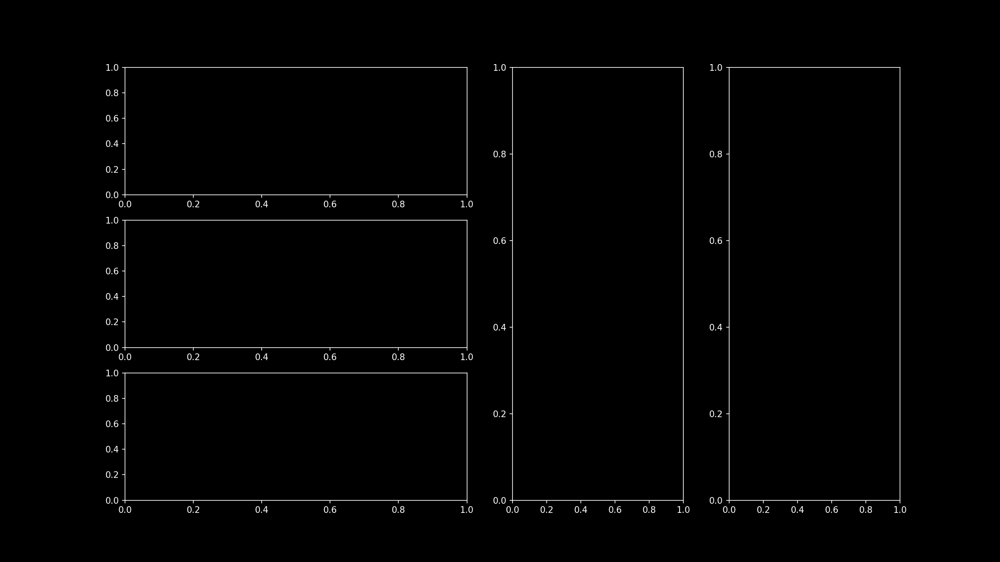

KeyError: 'groundTruths'

<IPython.core.display.Javascript object>


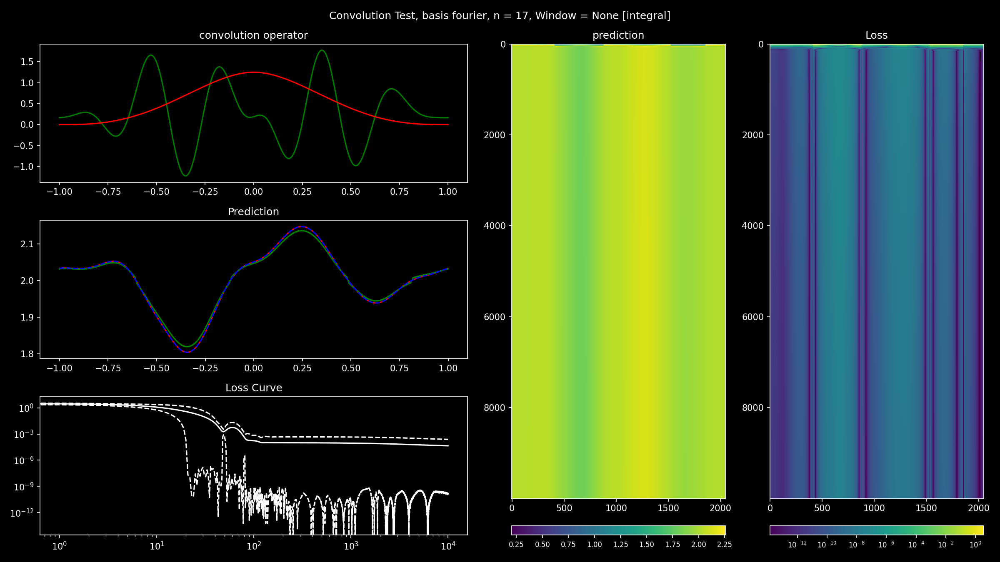

In [41]:
fig, axis = plt.subplot_mosaic('''DBC
ABC
EBC''', figsize=(16,9), sharex = False, width_ratios=[2,1,1])

def plot(fig, axis, mat, title, cmap = 'viridis', norm = 'linear'):
    im = axis.imshow(mat, cmap = cmap, norm = norm)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
    
axis['A'].plot(x[:,0], groundTruth.detach().cpu().numpy(), c = 'red')
ll = np.logspace(1, np.log10(iterations * epochs + 1), num = 100)
norm = LogNorm(vmin=1, vmax=iterations * epochs + 1)
    
axis['A'].plot(x[:,0], predictions[-1][:], c = 'green')
s = scatter_sum(baseArea * kernel(torch.abs(distance[:,0]), particleSupport), i, dim = 0, dim_size = x.shape[0])
axis['A'].plot(x[:,0], s, c = 'blue', ls = '--')
    
    
plot(fig, axis['B'], torch.vstack(predictions)[:,:], title = 'prediction', norm = 'linear')
plot(fig, axis['C'], torch.vstack(losses)[:,:], title = 'Loss', norm = 'log')

xSynthetic, featuresSynthetic, iSynthetic, jSynthetic = generateSyntheticData(511, device)

steps = iterations * epochs
ls = np.logspace(0, np.log10(steps), num =  50)
ls = [int(np.floor(f)) for f in ls]
ls = np.unique(ls).tolist()

axis['D'].plot(xSynthetic[:,0].detach().cpu().numpy(), model(featuresSynthetic, iSynthetic, jSynthetic, xSynthetic).detach().cpu().numpy(),ls='-',c= 'green', alpha = 0.95)
axis['D'].plot(xSynthetic[:,0].detach().cpu().numpy(), kernel(torch.abs(xSynthetic), 1).detach().cpu().numpy(), c = 'red')

axis['D'].set_title('convolution operator')
axis['A'].set_title('Prediction')

axis['E'].loglog(torch.mean(torch.vstack(losses), dim = 1), ls = '-', c = 'white')
axis['E'].loglog(torch.min(torch.vstack(losses), dim = 1)[0], ls = '--', c = 'white')
axis['E'].loglog(torch.max(torch.vstack(losses), dim = 1)[0], ls = '--', c = 'white')
axis['E'].set_title('Loss Curve')
fig.suptitle('Convolution Test, basis %s, n = %2d, Window = %s [%s]' % (basis, n, window if window is not None else 'None', windowNorm if windowNorm is not None else 'None'))

fig.tight_layout()

In [85]:
torch.min(torch.linalg.norm(distance, axis = 1))

tensor(0.)

In [118]:
from tqdm.notebook import tqdm

In [119]:
pb = tqdm(range(epochs * iterations))
epoch = 0
b, l, w = processDataLoaderIter(pb, iterations, epoch, lr, \
                                dataLoader, dataIter, batchSize, model, optimizer, \
                                particleData, settings, dataSet, \
                                lossFunction, getFeatures, getGroundTruth, None,\
                                train = True, prefix = '', augmentAngle = False, augmentJitter = False, jitterAmount = 0.01)

  0%|          | 0/5000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [113]:
testFile = trainingFiles[2]
testFrame = 0
unrollLength = 32



positions, velocities, areas, dudts, densities, setup = loadFrames(particleData, settings, dataSet, testFile, testFrame + np.arange(unrollLength), device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, dudt = flatten(positions, velocities, areas, dudts)
x = x[:,None]
distance = distance[:,None]
features = torch.vstack((u, torch.ones_like(v))).mT

In [115]:
predictions = []
with torch.no_grad():
    for i in range(unrollLength):
        predictions.append(modelStep([positions[i]], [velocities[i]], [densities[i]], setup).cpu())
predictions = torch.vstack(predictions)

<IPython.core.display.Javascript object>


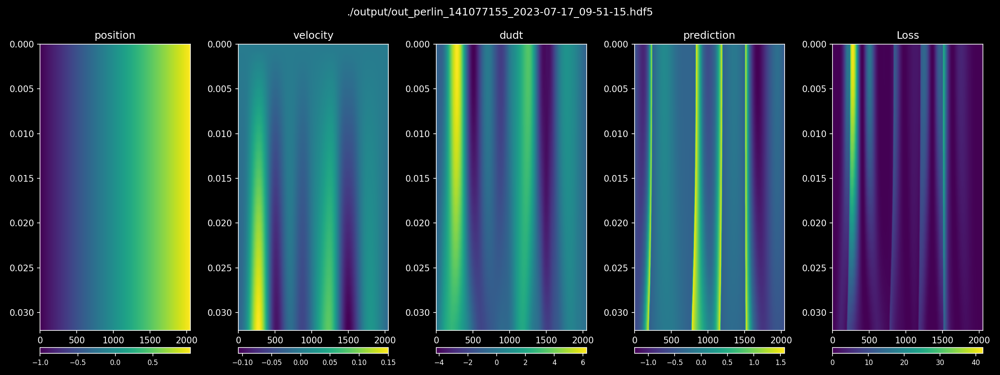

In [116]:

fig, axis = plt.subplots(1, 5, figsize=(16,6), sharex = False, sharey = False, squeeze = False)

def plot(fig, axis, mat, title, cmap = 'viridis'):
    im = axis.imshow(mat, extent = [0,numParticles,dt * (unrollLength + testFrame), testFrame * dt], cmap = cmap)
    axis.axis('auto')
    ax1_divider = make_axes_locatable(axis)
    cax1 = ax1_divider.append_axes("bottom", size="2%", pad="6%")
    cb1 = fig.colorbar(im, cax=cax1,orientation='horizontal')
    cb1.ax.tick_params(labelsize=8) 
    axis.set_title(title)
plot(fig,axis[0,0], x.reshape((unrollLength, numParticles)), 'position')
plot(fig,axis[0,1], u.reshape((unrollLength, numParticles)), 'velocity')
plot(fig,axis[0,2], dudt.reshape((unrollLength, numParticles)) / dt, 'dudt')
plot(fig,axis[0,3], predictions, 'prediction')
plot(fig,axis[0,4], (dudt.reshape((unrollLength, numParticles)) / dt - predictions)**2, 'Loss')
# plot(fig,axis[0,1], fluidDensity, 'density')
# plot(fig,axis[0,2], fluidPressure, 'pressure')
# plot(fig,axis[0,3], fluidVelocities, 'velocity', 'RdBu')
# plot(fig,axis[0,4], dudt, 'dudt', 'RdBu')

fig.suptitle(trainingFiles[0])
fig.tight_layout()

In [51]:

positions, velocities, areas, dudts, setup = loadBatch(particleData, settings, dataSet, bdata, device)

i, j, distance, direction = batchedNeighborsearch(positions, setup)
x, u, v, dudt = flatten(positions, velocities, areas, dudts)
x = x[:,None]
distance = distance[:,None]
features = torch.vstack((u, torch.ones_like(v))).mT

In [52]:
model(features, i, j, distance).reshape(4,2048)

tensor([[-0.0576, -0.0575, -0.0574,  ..., -0.0579, -0.0577, -0.0577],
        [-0.0355, -0.0355, -0.0354,  ..., -0.0357, -0.0357, -0.0356],
        [-0.0245, -0.0244, -0.0242,  ..., -0.0249, -0.0248, -0.0246],
        [-0.0670, -0.0671, -0.0672,  ..., -0.0667, -0.0668, -0.0669]],
       device='cuda:0', grad_fn=<ReshapeAliasBackward0>)

In [48]:
print(x.shape, x.reshape(4,2048))
print(positions)

torch.Size([8192, 1]) tensor([[-1.0040, -1.0030, -1.0020,  ...,  0.9931,  0.9940,  0.9950],
        [-1.0024, -1.0014, -1.0004,  ...,  0.9945,  0.9955,  0.9966],
        [-0.9568, -0.9558, -0.9547,  ...,  1.0401,  1.0411,  1.0422],
        [-1.0343, -1.0333, -1.0323,  ...,  0.9627,  0.9637,  0.9647]],
       device='cuda:0')
[tensor([-1.0040, -1.0030, -1.0020,  ...,  0.9931,  0.9940,  0.9950],
       device='cuda:0'), tensor([-1.0024, -1.0014, -1.0004,  ...,  0.9945,  0.9955,  0.9966],
       device='cuda:0'), tensor([-0.9568, -0.9558, -0.9547,  ...,  1.0401,  1.0411,  1.0422],
       device='cuda:0'), tensor([-1.0343, -1.0333, -1.0323,  ...,  0.9627,  0.9637,  0.9647],
       device='cuda:0')]
